<a href="https://colab.research.google.com/github/hvkchaitanya7/grp3capstoneprj/blob/main/ImageCaptionGroup3_BaseLine_resnet50_LSTM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Reference (GitHub):- https://github.com/hlamba28/Automatic-Image-Captioning/blob/master/Automatic%20Image%20Captioning.ipynb

In [1]:
!rm -rf Flickr8k_Dataset.zip
!rm -rf Flickr8k_text.zip
!wget https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_Dataset.zip -O Flickr8k_Dataset.zip
!wget https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_text.zip -O Flickr8k_text.zip
!unzip Flickr8k_Dataset.zip
!unzip Flickr8k_text.zip

Streaming output truncated to the last 5000 lines.
  inflating: __MACOSX/Flicker8k_Dataset/._3429391520_930b153f94.jpg  
  inflating: Flicker8k_Dataset/3429465163_fb8ac7ce7f.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429465163_fb8ac7ce7f.jpg  
  inflating: Flicker8k_Dataset/3429581486_4556471d1a.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429581486_4556471d1a.jpg  
  inflating: Flicker8k_Dataset/3429641260_2f035c1813.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429641260_2f035c1813.jpg  
  inflating: Flicker8k_Dataset/3429956016_3c7e3096c2.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429956016_3c7e3096c2.jpg  
  inflating: Flicker8k_Dataset/3430100177_5864bf1e73.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430100177_5864bf1e73.jpg  
  inflating: Flicker8k_Dataset/3430287726_94a1825bbf.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430287726_94a1825bbf.jpg  
  inflating: Flicker8k_Dataset/3430526230_234b3550f6.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430

In [2]:

import numpy as np
from numpy import array
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import string
import os
from PIL import Image
import glob
from pickle import dump, load
from time import time
from keras.preprocessing import sequence
from keras.models import Sequential
from keras import optimizers
from keras import Input, layers
from keras.applications.inception_v3 import preprocess_input
from keras.layers import LSTM, Embedding, TimeDistributed, Dense, RepeatVector, Activation, Flatten, Reshape, concatenate, Dropout, BatchNormalization
from keras.layers.wrappers import Bidirectional
from keras.layers.merge import add
from keras.applications.inception_v3 import InceptionV3
from keras.preprocessing import image
from keras.models import Model
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.utils import plot_model
from nltk.translate.bleu_score import sentence_bleu
import tensorflow as tf

In [3]:
# from keras.optimizers import Adam, RMSprop
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.optimizers import Adam, RMSprop

In [4]:
# load doc into memory
def load_doc(filename):
	# open the file as read only
	file = open(filename, 'r')
	# read all text
	text = file.read()
	# close the file
	file.close()
	return text

filename = "/content/Flickr8k.token.txt"
# load descriptions
doc = load_doc(filename)
print(doc[:300])

1000268201_693b08cb0e.jpg#0	A child in a pink dress is climbing up a set of stairs in an entry way .
1000268201_693b08cb0e.jpg#1	A girl going into a wooden building .
1000268201_693b08cb0e.jpg#2	A little girl climbing into a wooden playhouse .
1000268201_693b08cb0e.jpg#3	A little girl climbing the s


In [5]:
def load_descriptions(doc):
	mapping = dict()
	# process lines
	for line in doc.split('\n'):
		# split line by white space
		tokens = line.split()
		if len(line) < 2:
			continue
		# take the first token as the image id, the rest as the description
		image_id, image_desc = tokens[0], tokens[1:]
		# extract filename from image id
		image_id = image_id.split('.')[0]
		# convert description tokens back to string
		image_desc = ' '.join(image_desc)
		# create the list if needed
		if image_id not in mapping:
			mapping[image_id] = list()
		# store description
		mapping[image_id].append(image_desc)
	return mapping


In [6]:
# parse descriptions
descriptions = load_descriptions(doc)
print('Loaded: %d ' % len(descriptions))

Loaded: 8092 


In [ ]:
descriptions

In [ ]:
list(descriptions.keys())[:5]

In [ ]:
descriptions['1000268201_693b08cb0e']

In [7]:
def clean_descriptions(descriptions):
	# prepare translation table for removing punctuation
	table = str.maketrans('', '', string.punctuation)
	for key, desc_list in descriptions.items():
		for i in range(len(desc_list)):
			desc = desc_list[i]
			# tokenize
			desc = desc.split()
			# convert to lower case
			desc = [word.lower() for word in desc]
			# remove punctuation from each token
			desc = [w.translate(table) for w in desc]
			# remove hanging 's' and 'a'
			desc = [word for word in desc if len(word)>1]
			# remove tokens with numbers in them
			desc = [word for word in desc if word.isalpha()]
			# store as string
			desc_list[i] =  ' '.join(desc)

# clean descriptions
clean_descriptions(descriptions)

In [8]:
# convert the loaded descriptions into a vocabulary of words
def to_vocabulary(descriptions):
	# build a list of all description strings
	all_desc = set()
	for key in descriptions.keys():
		[all_desc.update(d.split()) for d in descriptions[key]]
	return all_desc

# summarize vocabulary
vocabulary = to_vocabulary(descriptions)
print('Original Vocabulary Size: %d' % len(vocabulary))

Original Vocabulary Size: 8763


In [9]:
# save descriptions to file, one per line
def save_descriptions(descriptions, filename):
	lines = list()
	for key, desc_list in descriptions.items():
		for desc in desc_list:
			lines.append(key + ' ' + desc)
	data = '\n'.join(lines)
	file = open(filename, 'w')
	file.write(data)
	file.close()

save_descriptions(descriptions, 'descriptions.txt')


In [10]:
# load a pre-defined list of photo identifiers
def load_set(filename):
	doc = load_doc(filename)
	dataset = list()
	# process line by line
	for line in doc.split('\n'):
		# skip empty lines
		if len(line) < 1:
			continue
		# get the image identifier
		identifier = line.split('.')[0]
		dataset.append(identifier)
	return set(dataset)

# load training dataset (6K)
filename = '/content/Flickr_8k.trainImages.txt'
train = load_set(filename)
print('Dataset: %d' % len(train))

Dataset: 6000


In [ ]:
train

In [11]:
# Below path contains all the images
images = '/content/Flicker8k_Dataset/'
# Create a list of all image names in the directory
img = glob.glob(images + '*.jpg')

In [12]:
# Below file conatains the names of images to be used in train data
train_images_file = '/content/Flickr_8k.trainImages.txt'
# Read the train image names in a set
train_images = set(open(train_images_file, 'r').read().strip().split('\n'))

# Create a list of all the training images with their full path names
train_img = []

for i in img: # img is list of full path names of all images
    if i[len(images):] in train_images: # Check if the image belongs to training set
        train_img.append(i) # Add it to the list of train images

In [13]:
# Below file conatains the names of images to be used in validation data
val_images_file = '/content/Flickr_8k.devImages.txt'
# Read the validation image names in a set
val_images = set(open(val_images_file, 'r').read().strip().split('\n'))

# Create a list of all the validation images with their full path names
val_img = []

for i in img: # img is list of full path names of all images
    if i[len(images):] in val_images: # Check if the image belongs to val set
        val_img.append(i) # Add it to the list of val images

In [14]:
# Below file conatains the names of images to be used in test data
test_images_file = '/content/Flickr_8k.testImages.txt'
# Read the validation image names in a set# Read the test image names in a set
test_images = set(open(test_images_file, 'r').read().strip().split('\n'))

# Create a list of all the test images with their full path names
test_img = []

for i in img: # img is list of full path names of all images
    if i[len(images):] in test_images: # Check if the image belongs to test set
        test_img.append(i) # Add it to the list of test images

In [15]:
# load clean descriptions into memory
def load_clean_descriptions(filename, dataset):
	# load document
	doc = load_doc(filename)
	descriptions = dict()
	for line in doc.split('\n'):
		# split line by white space
		tokens = line.split()
		# split id from description
		image_id, image_desc = tokens[0], tokens[1:]
		# skip images not in the set
		if image_id in dataset:
			# create list
			if image_id not in descriptions:
				descriptions[image_id] = list()
			# wrap description in tokens
			desc = 'startseq ' + ' '.join(image_desc) + ' endseq'
			# store
			descriptions[image_id].append(desc)
	return descriptions

# descriptions
train_descriptions = load_clean_descriptions('descriptions.txt', train)
print('Descriptions: train=%d' % len(train_descriptions))

Descriptions: train=6000


In [18]:
filename_val = '/content/Flickr_8k.devImages.txt'
val=load_set(filename_val)
val_descriptions = load_clean_descriptions('descriptions.txt', val)

In [17]:
def preprocess(image_path):
    # Convert all the images to size 224X224 as expected by the inception v3 model
    img = image.load_img(image_path, target_size=(224, 224,3))
    # Convert PIL image to numpy array of 3-dimensions
    x = image.img_to_array(img)
    #print(x.shape())
    # Add one more dimension
    x = np.expand_dims(x, axis=0)
    # preprocess the images using preprocess_input() from inception module
    #x = preprocess_input(x)
    return x

In [20]:
# Load the ResNet v3 model
model = ResNet50(include_top=True,weights='imagenet',input_shape=(224, 224,3),pooling="avg")

102981632/102967424 [==============================] - 1s 0us/step


In [ ]:
model.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                           

In [21]:
# Create a new model, by removing the last layer (output layer) from the inception v3
model_new = Model(model.input, model.layers[-2].output)

In [22]:
model_new.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                              

In [23]:
# Function to encode a given image into a vector of size (2048, )
def encode(image):
    image = preprocess(image) # preprocess the image
    fea_vec = model_new.predict(image) # Get the encoding vector for the image
    fea_vec = np.reshape(fea_vec, fea_vec.shape[1]) # reshape from (1, 2048) to (2048, )
    return fea_vec

In [24]:
# Call the funtion to encode all the train images
# This will take a while on CPU - Execute this only once
start = time()
encoding_train = {}
for img in train_img:
    encoding_train[img[len(images):]] = encode(img)
print("Time taken in seconds =", time()-start)

Time taken in seconds = 395.45228242874146


In [25]:
pkl_train_file="/content/Pickle_ResNet/encoded_train_images.pkl"

In [27]:
!mkdir '/content/Pickle_ResNet/'

In [28]:
# Save the bottleneck train features to disk
with open(pkl_train_file, "wb") as encoded_pickle:
    dump(encoding_train, encoded_pickle)

    # /content/sample_data/Pickle/encoded_train_images.pkl

In [29]:
# Call the funtion to encode all the validation images
# This will take a while on CPU - Execute this only once
start = time()
encoding_val = {}
for img in val_img:
    encoding_val[img[len(images):]] = encode(img)
print("Time taken in seconds =", time()-start)

Time taken in seconds = 61.18552231788635


In [32]:
pkl_val_file = "/content/Pickle_ResNet/encoded_val_images.pkl"

In [33]:
# Save the bottleneck val features to disk
with open(pkl_val_file, "wb") as encoded_pickle:
    dump(encoding_val, encoded_pickle)

In [35]:
# Call the funtion to encode all the test images - Execute this only once
start = time()
encoding_test = {}
for img in test_img:
    encoding_test[img[len(images):]] = encode(img)
print("Time taken in seconds =", time()-start)

Time taken in seconds = 63.40164589881897


In [36]:
pkl_test_file = "/content/Pickle_ResNet/encoded_test_images.pkl"

In [37]:

# Save the bottleneck test features to disk
with open(pkl_test_file, "wb") as encoded_pickle:
    dump(encoding_test, encoded_pickle)

In [38]:
train_features = load(open(pkl_train_file, "rb"))
print('Photos: train=%d' % len(train_features))

Photos: train=6000


In [39]:
val_features = load(open(pkl_val_file, "rb"))
print('Photos: val=%d' % len(val_features))

Photos: val=1000


In [40]:
# Create a list of all the training captions
all_train_captions = []
for key, val in train_descriptions.items():
    for cap in val:
        all_train_captions.append(cap)
len(all_train_captions)

30000

In [41]:
# Consider only words which occur at least 10 times in the corpus
word_count_threshold = 10
word_counts = {}
nsents = 0
for sent in all_train_captions:
    nsents += 1
    for w in sent.split(' '):
        word_counts[w] = word_counts.get(w, 0) + 1

vocab = [w for w in word_counts if word_counts[w] >= word_count_threshold]
print('preprocessed words %d -> %d' % (len(word_counts), len(vocab)))

preprocessed words 7578 -> 1651


In [42]:
ixtoword = {}
wordtoix = {}

ix = 1
for w in vocab:
    wordtoix[w] = ix
    ixtoword[ix] = w
    ix += 1

In [43]:
vocab_size = len(ixtoword) + 1 # one for appended 0's
vocab_size

1652

In [44]:
# convert a dictionary of clean descriptions to a list of descriptions
def to_lines(descriptions):
	all_desc = list()
	for key in descriptions.keys():
		[all_desc.append(d) for d in descriptions[key]]
	return all_desc

# calculate the length of the description with the most words
def max_length(descriptions):
	lines = to_lines(descriptions)
	return max(len(d.split()) for d in lines)

# determine the maximum sequence length
max_length = max_length(train_descriptions)
print('Description Length: %d' % max_length)

Description Length: 34


In [45]:
# data generator, intended to be used in a call to model.fit_generator()
def data_generator(descriptions, photos, wordtoix, max_length, num_photos_per_batch):
    X1, X2, y = list(), list(), list()
    n=0
    # loop for ever over images
    while 1:
        for key, desc_list in descriptions.items():
            n+=1
            # retrieve the photo feature
            photo = photos[key+'.jpg']
            for desc in desc_list:
                # encode the sequence
                seq = [wordtoix[word] for word in desc.split(' ') if word in wordtoix]
                # split one sequence into multiple X, y pairs
                for i in range(1, len(seq)):
                    # split into input and output pair
                    in_seq, out_seq = seq[:i], seq[i]
                    # pad input sequence
                    in_seq = pad_sequences([in_seq], maxlen=max_length)[0]
                    # encode output sequence
                    out_seq = to_categorical([out_seq], num_classes=vocab_size)[0]
                    # store
                    X1.append(photo)
                    X2.append(in_seq)
                    y.append(out_seq)
            # yield the batch data
            if n==num_photos_per_batch:
                yield [[array(X1), array(X2)], array(y)]
                X1, X2, y = list(), list(), list()
                n=0

In [46]:
!wget http://nlp.stanford.edu/data/glove.6B.zip

--2022-07-23 09:16:27--  http://nlp.stanford.edu/data/glove.6B.zip
Resolving nlp.stanford.edu (nlp.stanford.edu)... 171.64.67.140
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://nlp.stanford.edu/data/glove.6B.zip [following]
--2022-07-23 09:16:28--  https://nlp.stanford.edu/data/glove.6B.zip
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://downloads.cs.stanford.edu/nlp/data/glove.6B.zip [following]
--2022-07-23 09:16:28--  https://downloads.cs.stanford.edu/nlp/data/glove.6B.zip
Resolving downloads.cs.stanford.edu (downloads.cs.stanford.edu)... 171.64.64.22
Connecting to downloads.cs.stanford.edu (downloads.cs.stanford.edu)|171.64.64.22|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 862182613 (822M) [application/zip]
Saving to: ‘glove.6B.zip’

glov

In [47]:
!unzip glove*.zip

Archive:  glove.6B.zip
  inflating: glove.6B.50d.txt        
  inflating: glove.6B.100d.txt       
  inflating: glove.6B.200d.txt       
  inflating: glove.6B.300d.txt       


In [ ]:
!wget http://nlp.stanford.edu/data/glove.6B.200d.zip

--2022-07-16 05:25:47--  http://nlp.stanford.edu/data/glove.6B.200d.zip
Resolving nlp.stanford.edu (nlp.stanford.edu)... 171.64.67.140
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://nlp.stanford.edu/data/glove.6B.200d.zip [following]
--2022-07-16 05:25:47--  https://nlp.stanford.edu/data/glove.6B.200d.zip
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://downloads.cs.stanford.edu/nlp/data/glove.6B.200d.zip [following]
--2022-07-16 05:25:47--  https://downloads.cs.stanford.edu/nlp/data/glove.6B.200d.zip
Resolving downloads.cs.stanford.edu (downloads.cs.stanford.edu)... 171.64.64.22
Connecting to downloads.cs.stanford.edu (downloads.cs.stanford.edu)|171.64.64.22|:443... connected.
HTTP request sent, awaiting response... 404 Not Found
2022-07-16 05:25:47 ERROR 404: Not Found.


In [48]:

# Load Glove vectors
glove_dir = '/content/'
embeddings_index = {} # empty dictionary
f = open(os.path.join(glove_dir, 'glove.6B.200d.txt'), encoding="utf-8")

for line in f:
    values = line.split()
    word = values[0]
    coefs = np.asarray(values[1:], dtype='float32')
    embeddings_index[word] = coefs
f.close()
print('Found %s word vectors.' % len(embeddings_index))

Found 400000 word vectors.


In [50]:
vocab_size

1652

In [49]:
embedding_dim = 200

# Get 200-dim dense vector for each of the 10000 words in out vocabulary
embedding_matrix = np.zeros((vocab_size, embedding_dim))

for word, i in wordtoix.items():
    #if i < max_words:
    embedding_vector = embeddings_index.get(word)
    if embedding_vector is not None:
        # Words not found in the embedding index will be all zeros
        embedding_matrix[i] = embedding_vector

In [ ]:
embedding_matrix.shape

(1652, 200)

In [ ]:
embedding_matrix[1650,0:50]

array([ 0.20298   , -0.10048   , -0.33627   , -0.72679001,  0.23146001,
        0.22077   ,  0.42952001, -0.60758001,  0.85202003, -0.85326999,
       -0.88313001, -0.39104   ,  0.28290999, -0.23973   ,  0.35580999,
       -0.22188   , -0.44758001,  0.33155999, -0.14907999,  0.26605999,
        0.37055001,  0.076139  , -0.31450999, -0.68892002,  0.92940003,
        0.59457999,  0.32692   , -0.14501999, -0.13399   , -0.26473999,
        0.43072   , -0.06878   , -0.66360998, -0.37437001, -0.63537002,
        0.95183003, -0.48716   , -0.24009   ,  0.21712001,  0.78609002,
        0.52569002, -0.56200999,  0.20886999, -0.35106999, -0.35617   ,
       -0.52287   , -0.66702998,  0.59358001, -0.19891   ,  0.60021001])

In [ ]:
max_length

34

In [51]:
inputs1 = Input(shape=(2048,))
fe1 = Dropout(0.5)(inputs1)
fe2 = Dense(256, activation='relu')(fe1)
inputs2 = Input(shape=(max_length,))
se1 = Embedding(vocab_size, embedding_dim, mask_zero=True)(inputs2)
se2 = Dropout(0.5)(se1)
se3 = LSTM(256)(se2)
decoder1 = add([fe2, se3])
print(decoder1.shape)
decoder2 = Dense(256, activation='relu')(decoder1)
print(decoder2.shape)
outputs = Dense(vocab_size, activation='softmax')(decoder2)
model = Model(inputs=[inputs1, inputs2], outputs=outputs)

(None, 256)
(None, 256)


In [ ]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 34)]         0           []                               
                                                                                                  
 input_4 (InputLayer)           [(None, 2048)]       0           []                               
                                                                                                  
 embedding_1 (Embedding)        (None, 34, 200)      330400      ['input_5[0][0]']                
                                                                                                  
 dropout_2 (Dropout)            (None, 2048)         0           ['input_4[0][0]']                
                                                                                            

In [52]:
inputs1 = Input(shape=(2048,))
fe1 = Dropout(0.5)(inputs1)
fe2 = Dense(256, activation='relu')(fe1)
inputs2 = Input(shape=(max_length,))
se1 = Embedding(vocab_size, embedding_dim, mask_zero=True)(inputs2)
se2 = Dropout(0.5)(se1)
print('se2 shape', se2.shape)
se3 = LSTM(256,return_sequences =True)(se2)
decoder1 = add([fe2, se3])
print('decoder1 shape',decoder1.shape)
decoder2 = LSTM(256)(decoder1)
decoder3 = Dense(256, activation='relu')(decoder2)
print(decoder2.shape)
outputs = Dense(vocab_size, activation='softmax')(decoder3)
model = Model(inputs=[inputs1, inputs2], outputs=outputs)

se2 shape (None, 34, 200)
decoder1 shape (None, 34, 256)
(None, 256)


In [ ]:
model.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_15 (InputLayer)          [(None, 34)]         0           []                               
                                                                                                  
 input_14 (InputLayer)          [(None, 2048)]       0           []                               
                                                                                                  
 embedding_6 (Embedding)        (None, 34, 200)      330400      ['input_15[0][0]']               
                                                                                                  
 dropout_12 (Dropout)           (None, 2048)         0           ['input_14[0][0]']               
                                                                                            

In [53]:
model.layers[2].set_weights([embedding_matrix])
model.layers[2].trainable = False

In [54]:
model.compile(loss='categorical_crossentropy', optimizer='adam',metrics=['accuracy'])

In [55]:
epochs = 15
number_pics_per_bath = 20
steps = len(train_descriptions)//number_pics_per_bath

In [ ]:
for i in range(epochs):
    generator = data_generator(train_descriptions, train_features, wordtoix, max_length, number_pics_per_bath)
    model.fit_generator(generator, epochs=1, steps_per_epoch=steps, verbose=1)
    model.save('./model_weights/model_' + str(i) + '.h5')

In [ ]:
for i in range(epochs):
    generator = data_generator(train_descriptions, train_features, wordtoix, max_length, number_pics_per_bath)
    model.fit_generator(generator, epochs=1, steps_per_epoch=steps, verbose=1)
    model.save('./model_weights/model_' + str(i) + '.h5')

In [57]:
#Check accuracy along with validation set
for i in range(epochs):
    train_generator = data_generator(train_descriptions, train_features, wordtoix, max_length, number_pics_per_bath)
    val_generator = data_generator(val_descriptions, val_features, wordtoix, max_length, number_pics_per_bath)
    history = model.fit_generator(train_generator, epochs=1, steps_per_epoch=steps, validation_data=val_generator,validation_steps=50,verbose=1)
    model.save('./model_weights/model_' + str(i) + '.h5')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  """


300/300 [==============================] - 97s 322ms/step - loss: 2.4654 - accuracy: 0.4033 - val_loss: 3.4655 - val_accuracy: 0.3069


In [58]:
history.history

{'accuracy': [0.40334486961364746],
 'loss': [2.4653661251068115],
 'val_accuracy': [0.3068867623806],
 'val_loss': [3.4655330181121826]}

In [ ]:
scores = model.evaluate(val_generator,steps=300)

300/300 [==============================] - 33s 110ms/step - loss: 3.4655 - accuracy: 0.3069


In [ ]:
model.optimizer.lr = 0.0001
epochs = 30
number_pics_per_bath = 20
steps = len(train_descriptions)//number_pics_per_bath

In [ ]:
for i in range(epochs):
    generator = data_generator(train_descriptions, train_features, wordtoix, max_length, number_pics_per_bath)
    model.fit_generator(generator, epochs=1, steps_per_epoch=steps, verbose=1)
    #model.save('./model_weights/model_' + str(i) + '.h5')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  This is separate from the ipykernel package so we can avoid doing imports until


300/300 [==============================] - 98s 325ms/step - loss: 2.6974


In [60]:
model.save_weights('./model_weights/Resnet_model_LSTM_30.h5')

In [61]:
model.load_weights('./model_weights/Resnet_model_LSTM_30.h5')

In [62]:
images = '/content/Flicker8k_Dataset/'

In [63]:
with open(pkl_test_file, "rb") as encoded_pickle:
    encoding_test = load(encoded_pickle)

In [64]:
def greedySearch(photo):
    in_text = 'startseq'
    for i in range(max_length):
        sequence = [wordtoix[w] for w in in_text.split() if w in wordtoix]
        sequence = pad_sequences([sequence], maxlen=max_length)
        yhat = model.predict([photo,sequence], verbose=0)
        yhat = np.argmax(yhat)
        word = ixtoword[yhat]
        in_text += ' ' + word
        if word == 'endseq':
            break
    final = in_text.split()
    final = final[1:-1]
    final = ' '.join(final)
    return final

In [65]:
from nltk.translate.bleu_score import sentence_bleu
import tensorflow as tf
def get_bleuscore(pred_desc, image_name):
    cand_desc = pred_desc.split()
    #print("blue score desc", cand_desc)
    img_name = image_name.split(".jpg")[0]
    refer_desc = descriptions[img_name]
    refer_list = []
    for s in refer_desc:
         s = s.split()
         refer_list.append(s)
    #print(s)
    print("Expert Caption:",refer_desc)
    #print (refer_list)
    score = sentence_bleu(refer_list,cand_desc,weights=(0, 0, 1))
    #print(score)
    return(score)

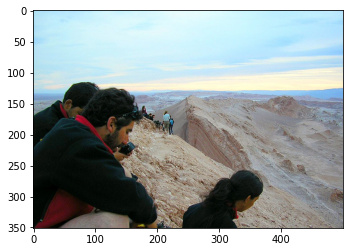

Expert Caption: ['few people standing on top of mountain taking pictures', 'group of people peering over the edge of large rocky mountain', 'several people on top of mountain look down at the ground', 'the mountain are light tan in color', 'three people sitting on cliff']
Blue score 0.3
caption: man in red shirt and jeans is standing on top of mountain


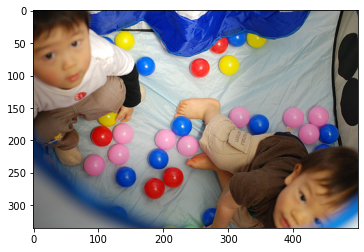

Expert Caption: ['two babies look up while they are playing in playpen with lot of balls', 'two boys in tentlike area with colorful balls on floor', 'two children look up', 'two kids are in pen playing with colorful balls', 'two young children play with colored balls']
Blue score 2.2250738585072626e-308
caption: little boy is playing with toy in an inflatable toy


/usr/local/lib/python3.7/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


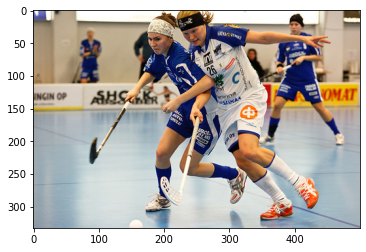

Expert Caption: ['female hockey player in blue is challenging the player in white for the ball', 'two girls are fighting for the ball in indoor field hockey', 'two women with blue and white uniforms playing floor hockey', 'two young female floor hockey players fight over the ball', 'women playing game similar to hockey but with no ice']
Blue score 1.4495000173229606e-308
caption: three young boys are playing with football


/usr/local/lib/python3.7/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


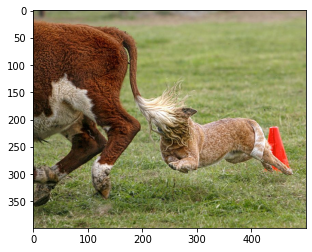

Expert Caption: ['dog biting the tail of cow', 'dog chasing an animals tail on the grass', 'small animal leaps behind larger animal the larger animal tail obscuring the smaller one face', 'small dog chases after large brown cow', 'tan animal is being swatted in the face by brown and white bull']
Blue score 1.8551618224632315e-308
caption: two brown dogs are playing with red ball in grassy field


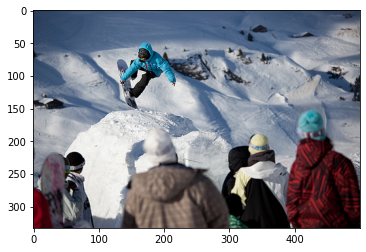

Expert Caption: ['group of people watching snowboarder perform trick', 'person snowboarding over large hump with onlookers in front of him', 'people are watching snowboarder perform trick in the air', 'several people are watching snowboarder with blue jacket jump', 'spectators watch snowboarder in midflight amid snowy landscape']
Blue score 0.12500000000000003
caption: group of people are standing on rocks overlooking the water


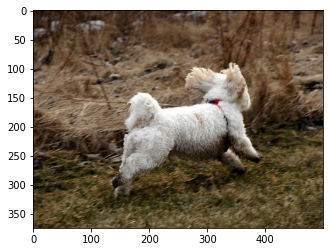

Expert Caption: ['fluffy white dog runs through the woods with his ears flapping in the breeze', 'small white dog is running across grassy field', 'white dog runs in the grass', 'white dog wearing red harness runs though the woods', 'the little white dog wearing the red collar is running in the grass']
Blue score 2.2250738585072626e-308
caption: two white dogs run through the water


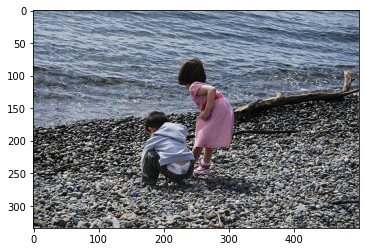

Expert Caption: ['little boy and little girl are playing with pebbles on the beach', 'small boy and girl on the beach edge looking at the ground', 'two kids playing on pebble beach by the water', 'two little kids play on pebble covered beach', 'two young child stand on the rocks near the edge of the water']
Blue score 0.07142857142857141
caption: two girls are standing in front of the water with their arms crossed in the air


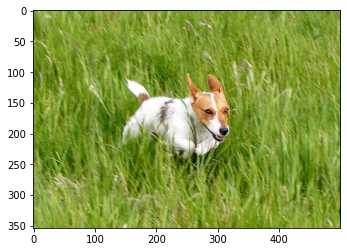

Expert Caption: ['medium sized brown and white streaked dog is running through tall grass', 'single tanandwhite dog dashes through tall green grass', 'small brown and white dog running through tall grass', 'small dog runs through grassy field', 'white and tan dog runs through the tall green grass']
Blue score 0.2857142857142857
caption: small white dog is running through field of grass


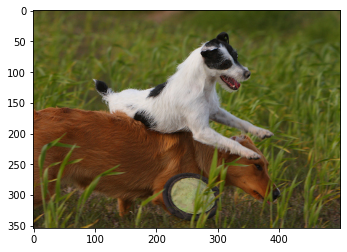

Expert Caption: ['little white and black dog is leaping over big brown dog head in field of green grass', 'small dog lands on big dog trying to get disc', 'small white dogs leaps over the back of larger dog to chase his toy', 'two dogs are playing in field of tall grass', 'white and black dog jumping over red haired dog in grass']
Blue score 1.3495755153097447e-308
caption: two dogs play in the grass


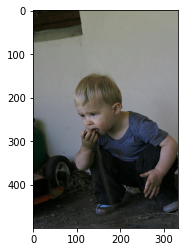

Expert Caption: ['child puts dirt into his mouth', 'little boy who is playing outdoors is tasting dirt', 'small child squats and puts dirt into his mouth', 'toddler eats dirt', 'the little boy wearing the blue shirt is putting dirt in his mouth']
Blue score 2.2250738585072626e-308
caption: small boy in white shirt and jeans is playing with toy


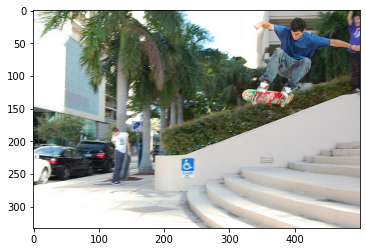

Expert Caption: ['boy in blue shirt jumps down stairs on skateboard', 'man flies through the air on his skateboard above white staircase', 'skateboarder jumps his board down flight of stairs', 'skateboarder sails over white steps', 'skateboarder jumping down stairs of building']
Blue score 2.2250738585072626e-308
caption: boy in red shirt is jumping into the air


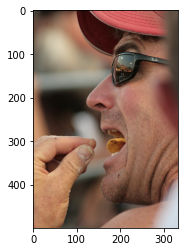

Expert Caption: ['man in red baseball cap eats chip', 'man wearing red hat has potato chip in his mouth', 'man wearing sunglasses and red cap putting chip in his mouth', 'man wearing sunglasses and red hat is opening his mouth wide and eating chip', 'man with sunglasses on puts chip in his mouth']
Blue score 2.2250738585072626e-308
caption: the girl is wearing red outfit and holding the hand of the child in the black and red


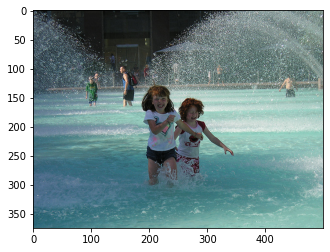

Expert Caption: ['two girls running through pool while water sprays over them', 'two girls run through sprinkler in pool', 'two smiling little girls playing in fountain with other people', 'two young girls are running through shallow water at pool', 'two young girls run through pool while water sprays them']
Blue score 1.991083571408152e-308
caption: small boy in blue shirt is running through puddle


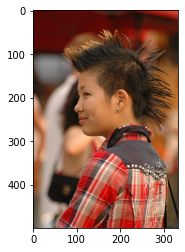

Expert Caption: ['girl with nose ring earring and mohawk', 'person with spiky hair looks to the left', 'profile of young person with punk hairstyle and pierced ear and nose in cowboy shirt', 'young person with mohawk and nose piercing in plaid shirt', 'the person is posing in red flannel shirt with mohawk']
Blue score 2.2250738585072626e-308
caption: the little girl is wearing pink dress and holding pink necklace


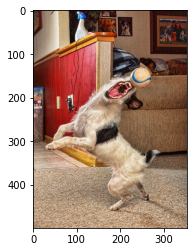

Expert Caption: ['dog catches ball in its mouth', 'dog leaps up to catch blue and tan ball', 'dog reaches to catch ball with its mouth', 'dog with its mouth open is about to catch ball in living room', 'white dog with black spots is catching baseball with its mouth']
Blue score 2.2250738585072626e-308
caption: young boy is jumping on bed


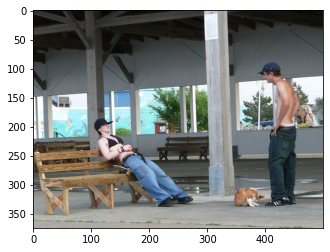

Expert Caption: ['shirtless man with brown and white dog looking at woman in jeans and bikini top who is relaxing on bench', 'shirtless man with dog next to him talking to shirtless girl slouching on bench', 'woman in bikini top is on the bench and man with no shirt is talking to her', 'woman is sitting on bench while talking to shirtless man', 'woman with hat is sitting on skateboard which is on top of bench and speaking with shirtless man']
Blue score 0.2222222222222222
caption: man in white shirt is sitting on bench in front of


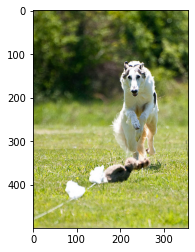

Expert Caption: ['dog chases stuffed animal attached to string', 'white and black dog chases after decoyanimal on string', 'white dog is chasing stuffed animal being pulled on string', 'the white dog is chasing toy that is attached to string across the grass', 'the white dog is running in the green grass']
Blue score 0.3333333333333333
caption: small white dog is running through the grass


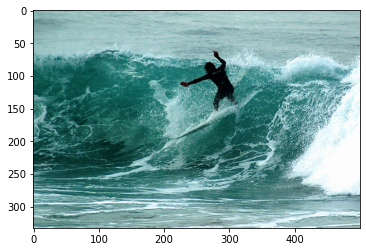

Expert Caption: ['person rides the waves on surfboard', 'person surfing', 'surfer is riding wave', 'surfer riding large wave', 'surfer riding surfboard in rough seas']
Blue score 0.4
caption: surfer is riding wave in the ocean


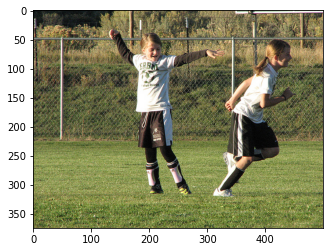

Expert Caption: ['children participate in sport on green field while in uniforms', 'the young soccer player enjoys the game', 'two girls in soccer strips are playing on sports field', 'two girls play on fenced in field', 'two girls wearing black and white uniforms run down grassy field']
Blue score 2.2250738585072626e-308
caption: boy in white shirt is playing with soccer ball in grassy field


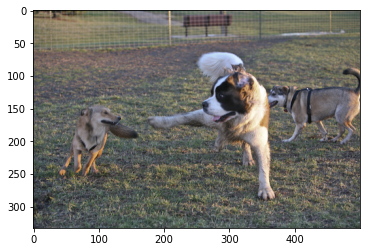

Expert Caption: ['big dog holds its paw out to keep another dog at bay', 'large dog wards off smaller dog', 'large dog plays with two smaller dogs on grass', 'the brown and white great dane plays with two yellow dogs in the grass', 'two smaller dogs and one larger dog with puffy white tail are playing in field']
Blue score 2.2250738585072626e-308
caption: two dogs are playing with frisbee


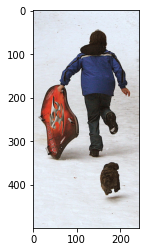

Expert Caption: ['boy drags his sled through the snow', 'boy in blue jacket carrying red sled running away followed by small dog', 'child running with snowboard on snow covered surface', 'child wearing blue coat runs along the snow while small dog follows', 'young boy plays with his dog in the snow']
Blue score 2.2250738585072626e-308
caption: little boy in red shirt and jeans is shoveling on the sand


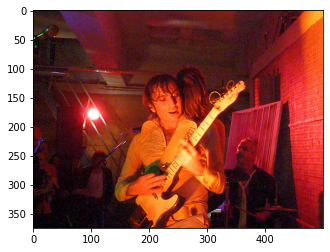

Expert Caption: ['man in fancy clothing plays guitar on stage', 'man playing guitar under the lights with other people in the background', 'woman plays guitar by round light', 'man playing guitar in dark room', 'the man played guitar in the band']
Blue score 2.2250738585072626e-308
caption: woman in white shirt and white hair is standing in front of crowd


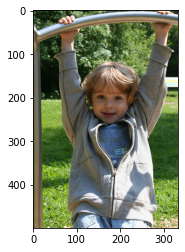

Expert Caption: ['child plays on playground equipment', 'girl is hanging on metal bar in park', 'happy child dangling from playground equipment smiles at the camera', 'little girl in sweatshirt jacket holding on to bar', 'child in grey sweatshirt hanging from metal bar']
Blue score 2.2250738585072626e-308
caption: little boy in yellow shirt is playing on swing


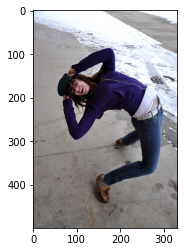

Expert Caption: ['girl in purple sweatshirt bends over backwards', 'girl bending backwards holding her hat', 'person bending backwards', 'person in blue sweatshirt is doing back bend', 'woman in blue bends over backwards on the street']
Blue score 2.2250738585072626e-308
caption: the little girl is wearing red outfit and holding red umbrella


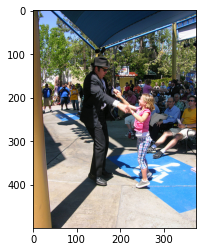

Expert Caption: ['man and girl stand in front of large crowd', 'man dances with girl', 'man in suit dances with young girl in front of an audience', 'man wearing black dances with young girl wearing pink shirt', 'the man wearing the blues brothers suit is dancing with the little girl in the pink top']
Blue score 0.12500000000000003
caption: man in red shirt is standing in front of the


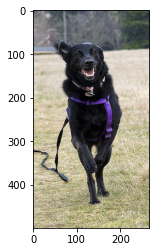

Expert Caption: ['black dog with purple collar and black leash runs in the grass', 'black dog with purple collar is running', 'black dog with purple collar running', 'black dog with purple collar running', 'the black dog is wearing purple collar with black leash as he is running']
Blue score 2.2250738585072626e-308
caption: two black dogs run through the grass


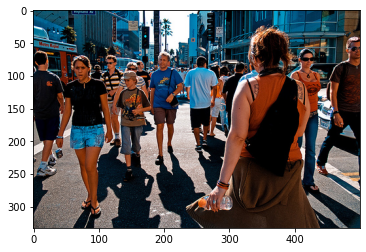

Expert Caption: ['crowd of people walk down busy sidewalk', 'group of different people are walking in all different directions in city', 'group of people walking city street in warm weather', 'busy intersection in the summer time in city', 'people in summer clothes are walking on the sidewalk of large city']
Blue score 2.2250738585072626e-308
caption: group of young children are walking down the street


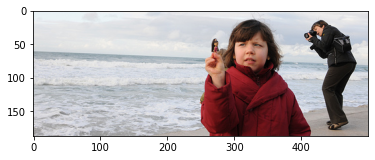

Expert Caption: ['child on the beach while woman takes pictures nearby', 'little girl in red at the beach while adult points camera', 'man and girl are at the shoreline while the man takes picture and the girl hods doll', 'woman is taking photograph on beach at the edge of the water while girl stands in the foreground', 'woman taking pictures of the surf and child in the foreground']
Blue score 1.9636207881546135e-308
caption: woman in red bikini walks along the beach


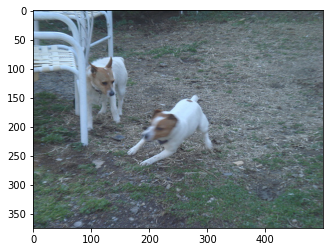

Expert Caption: ['white dog runs past another dog who is standing beside some patio furniture', 'two dogs are outside near patio furniture', 'two small brown and white dogs standing beside some white chairs', 'two small dogs play on the lawn', 'two small white dogs play in the yard']
Blue score 2.2250738585072626e-308
caption: white dog is running through the grass


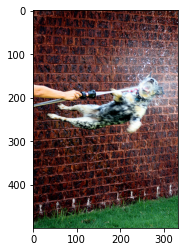

Expert Caption: ['dog gets sprayed by hose', 'dog is being sprayed with water', 'dog jumping through the air getting hit by water', 'an animal is hosed down by brick wall', 'leaping dog sprayed by off screen person with hose']
Blue score 2.2250738585072626e-308
caption: dog is jumping into the air to catch frisbee


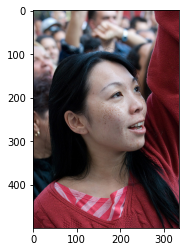

Expert Caption: ['closeup picture of girl with long black hair and one hand raised in the air', 'lady with dark hair dressed in red clothing with left arm in the air', 'woman in red shirt with her arm raised', 'woman in red sweater raises her hand in crowd', 'woman raises her hand']
Blue score 2.2250738585072626e-308
caption: young boy with curly hair is blowing bubbles in the water


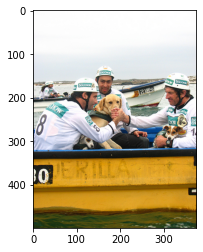

Expert Caption: ['group of men in yellow boat with their dogs', 'the men shake hands while another man and dogs look on', 'the three men and three dogs floated in the yellow boat', 'three men in team uniforms are surrounding yellow dog in boat', 'two men huddle around dog']
Blue score 2.2250738585072626e-308
caption: woman in green shirt is standing next to an umbrella


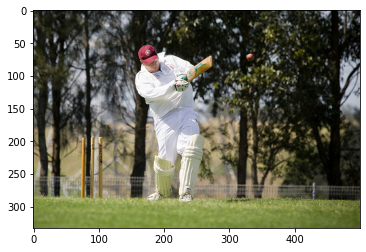

Expert Caption: ['cricket batter dressed all in white makes hit', 'man dressed in white and wearing red cap plays on the grass', 'man in rugby uniform hitting ball in grassy field', 'man playing cricket', 'cricket player with red cap hits the ball outdoors']
Blue score 2.031716533983919e-308
caption: young girl in pink shirt is jumping up in the air


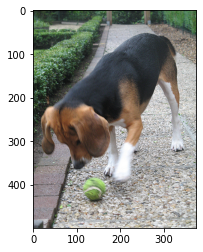

Expert Caption: ['beagle is playing with tennis ball', 'puppy dog is playing with tennis ball', 'puppy is playing with tennis ball on wellkept path lined with groomed bushes', 'puppy plays with tennis ball on stone path', 'whitefooted beagle plays with tennis ball on garden path']
Blue score 0.2857142857142857
caption: black and brown dog is playing with soccer ball


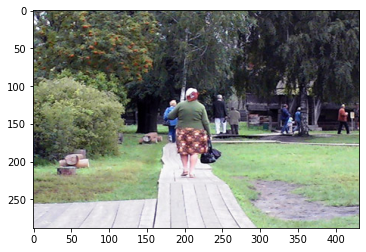

Expert Caption: ['woman in skirt walks down path', 'woman walks on boards', 'woman with scarf on her head walks down wooden boardwalk', 'several people in park walking on low wooden boardwalk', 'the woman wearing the brown skirt is carrying black bag along wooden walkway']
Blue score 2.2250738585072626e-308
caption: little boy in red shirt is running through the grass


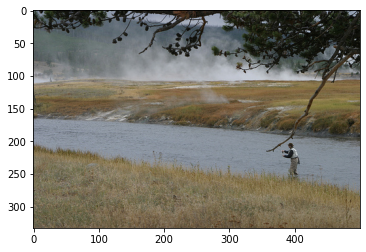

Expert Caption: ['man is fly fishing alon in stream', 'man is wading in river', 'man fly fishing in small river with steam in the background', 'person fishing in river', 'the man is standing in the river next to smoking grass']
Blue score 2.2250738585072626e-308
caption: man is climbing large rock formation


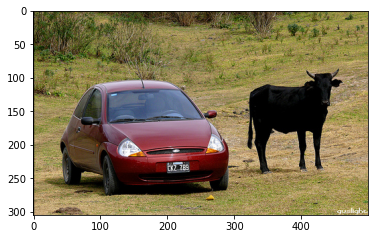

Expert Caption: ['bull stands in field next to red car', 'red car is parked next to black bull in grassy field', 'red car parked next to cow in field', 'large black animal is as large as small red car', 'there is small red car with black bull standing beside it in the middle of field']
Blue score 1.928867353251809e-308
caption: two children are playing in the water


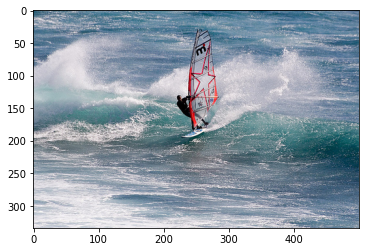

Expert Caption: ['man parasails in the waves', 'man rides large waves on wind sail', 'man windsurfs in the ocean', 'person parasails on the crest of wave', 'windsurfer in the waves of the ocean']
Blue score 0.25
caption: man is surfing in the ocean


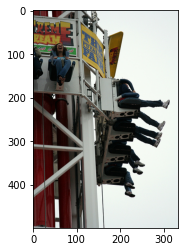

Expert Caption: ['person is laughing on roller coaster ride', 'photo of ride at an amusement park on an overcast day', 'people are in ride that drops you from great height', 'people on an amusement park ride', 'people on ride at fair']
Blue score 2.2250738585072626e-308
caption: boy is jumping over bar in front of an alley


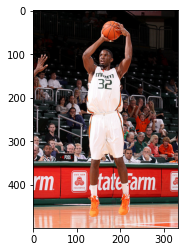

Expert Caption: ['basketball player preparing to shoot the ball', 'basketball player takes shot', 'black man playing basketball with orange shoes', 'basketball player with on jersey jumps to make shot crowd in background', 'miami basketball player shooting']
Blue score 1.8834843577582417e-308
caption: two men in karate arts match


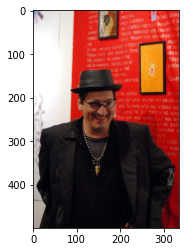

Expert Caption: ['man dressed in black wearing hat and glasses in front of red wall', 'man in black hat stands in front of red wall', 'man wearing all black and black hat is smiling', 'man with hat glasses jewelry and jacket stands against an orange wall', 'there is man with glasses and hat wearing black suit jacket indoors']
Blue score 0.08333333333333333
caption: man in black shirt and hat is standing next to man in black jacket


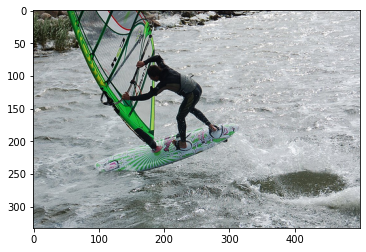

Expert Caption: ['kite surfer begins to fall in the ocean', 'man parasails in the choppy water', 'man wakeboards on choppy water', 'man windsurfs in wetsuit', 'windsurfer is balancing on choppy water']
Blue score 2.2250738585072626e-308
caption: man is climbing rock


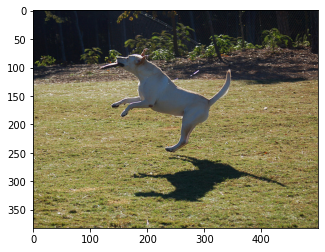

Expert Caption: ['dog is jumping to catch frisbee and casts perfect shadow', 'dog jumps and catches frisbee in the grass', 'dog jumps and catches toy', 'white dog leaps to catch an object', 'yellow lab jumping up to catch toy']
Blue score 2.2250738585072626e-308
caption: the dog is carrying red frisbee in its mouth


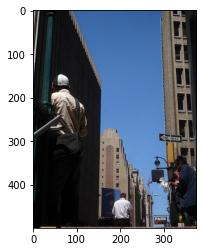

Expert Caption: ['city street has three people walking in different directions', 'man stands by building while others are nearby', 'men walk down street with skyscrapers in the background', 'the buildings are brown and the sky is blue', 'three men on city street with the shot taken up and out toward the buildings']
Blue score 2.2250738585072626e-308
caption: man and woman are standing outside of building


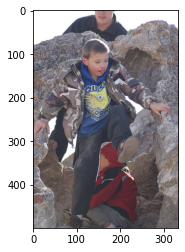

Expert Caption: ['boy climbs rocks', 'boy crawls through rock tunnel with his brother and father behind him', 'man watches two small boys playing in naturally formed rock', 'children playing on rocks', 'kids play in rocky area']
Blue score 2.2250738585072626e-308
caption: man in red shirt and hat is standing on rock with his arms outstretched


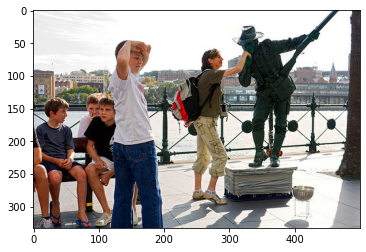

Expert Caption: ['group of tourists stand around as lady puts her hand near the mouth of statue', 'woman is making statue pretend to kiss her hand beside four boys at bench', 'woman posing with statue alongside group of boys', 'woman with backpack leans again statue while group of boys sit on bench talking', 'woman gets her hand kissed by living statue street artist']
Blue score 1.221146424717419e-308
caption: children are playing with hula


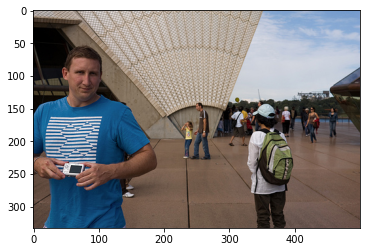

Expert Caption: ['man holding digital camera standing outside of huge building', 'man in blue shirt holding camera', 'man in blue tshirt holds camera', 'man wearing blue holds camera', 'the man in blue shirt is holding camera near to boy wearing backpack']
Blue score 2.2250738585072626e-308
caption: woman in white dress and pink pants walks down sidewalk


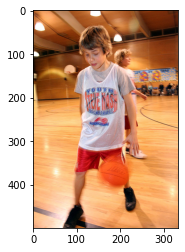

Expert Caption: ['boy dribbles basketball in the gymnasium', 'boy dribbling basketball in gym', 'boy wearing steve nash shirt dribbles basketball on an indoor court', 'child in gray tshirt is bouncing basketball on basketball court', 'one little boy dribbles his basketball']
Blue score 2.2250738585072626e-308
caption: little girl in pink dress is running in the street


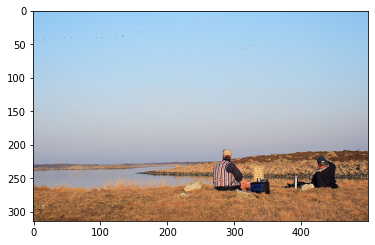

Expert Caption: ['two men sitting on the bank of lake with an ice chest', 'two people having picnic by lake', 'two people having picnic by the shore', 'two people sitting on grass in front of lake looking at the sky', 'two people with hats looking at lake while sitting on yellowgrassed hill']
Blue score 2.031716533983919e-308
caption: group of people are walking on the beach near the ocean


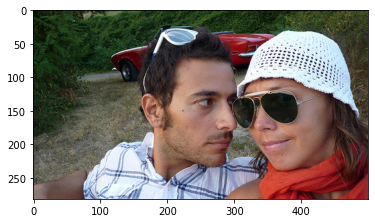

Expert Caption: ['couple practice different ways to wear sunglasses in front of red car', 'girl and boy with sunglasses and red car behind them', 'man with sunglasses and woman with hat are in front of car', 'man with sunglasses on his head is looking at the woman with white hat and red scarf next to him whilst standing in front of red sports car', 'woman in crochet hat and sunglasses smiles while the man beside her in plaid short and sunglasses looks behind her']
Blue score 2.2250738585072626e-308
caption: young boy with red headband and blue bandanna is wearing red bandanna


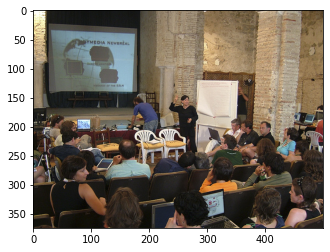

Expert Caption: ['class full of students', 'classroom of students watching presentation', 'conference is being held that involves laptops and big screen presentations', 'group of people are at conference watching slideshow', 'man is giving presentation in front of lot of people']
Blue score 0.14285714285714285
caption: people are sitting in front of building with candles


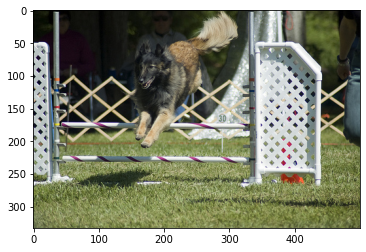

Expert Caption: ['black and brown dog jumping over two white and purple stiped poles', 'dog jumps over hurdle in the grass', 'dog jumps over an obstacle', 'black and brown dog jumping over hurdle with white supports', 'dog performing during an outdoor dog show']
Blue score 2.2250738585072626e-308
caption: man is standing in front of tree


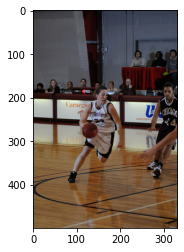

Expert Caption: ['basketball player wearing black and white uniform dribbles the ball', 'at women basketball game white skinned woman dribbles against the chicago defense', 'basketball players in action', 'the basketball player in white is dribbling the ball towards the player in black', 'woman in white dribbling basketball']
Blue score 0.11111111111111109
caption: woman in white and white skirt is jumping in the air


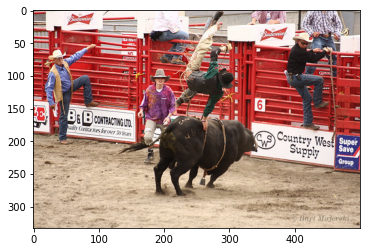

Expert Caption: ['man is roping bull in rodeo while others in cowboy hats watch', 'man is up in the air with one hand on bull', 'rodeo rider gets tossed up into the air by black bull as fellow cowboys look on', 'man getting thrown in the air while bull riding', 'the man in black is flying off the full in front of red fence']
Blue score 1.6720924800836196e-308
caption: two people are riding horses at station


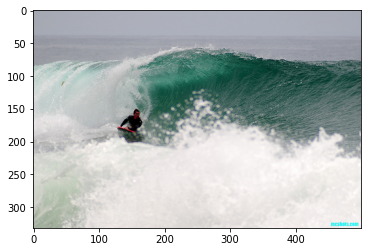

Expert Caption: ['man dressed in black is surfing on large blue wave', 'man rides surfboard through rough white and blue water', 'surfer catches nice wave in the ocean and tries to pull himself up', 'surfer is riding wave', 'surfer rides the waves']
Blue score 0.3333333333333333
caption: man is surfing on wave


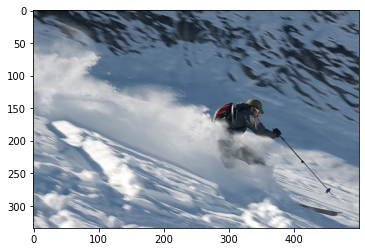

Expert Caption: ['man is skiing down mountain', 'person dressed in red and grey is skiing down snowy slope', 'skier is throwing up snow as he skis off piste', 'skier skiing downhill in cloud of snow', 'skier wearing white sunglasses is skiing down snowy mountain very fast']
Blue score 0.3333333333333333
caption: person skiing down snowy hill


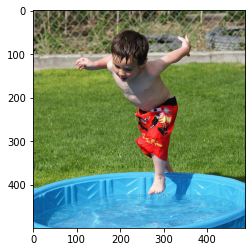

Expert Caption: ['boy wearing red shorts is jumping into paddling pool', 'little boy in red trunks plays in kiddie pool', 'little boy is jumping into an outdoor kiddie pool', 'little boy jumps into child pool in backyard', 'young boy wearing red swimsuit jumps into blue kiddie pool']
Blue score 2.2250738585072626e-308
caption: young boy in blue shirt is playing with ball


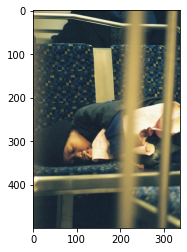

Expert Caption: ['child in black cap sleeping across two chairs', 'small boy in hat asleep on padded bench', 'small child sucks his thumb while sleeping with pink blanket on multicolored seat', 'young boy wearing dark blue hat sleeps on bench at terminal', 'small boy sleeping on seats and sucking his thumb']
Blue score 2.2250738585072626e-308
caption: woman in white shirt and white pants is walking past bridge


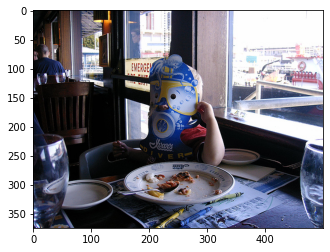

Expert Caption: ['child sitting at restaurant table holding paper mask against his face', 'child with mask on sitting at table with plate in front', 'young child wearing mask at ivars', 'child in restaurant posing with paper mask', 'the boy is wearing cardboard scuba mask at the restaurant']
Blue score 2.2250738585072626e-308
caption: boy is sitting in chair with an umbrella in her hand


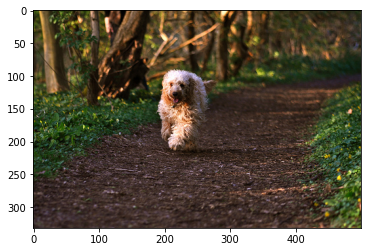

Expert Caption: ['dog runs along forest lane', 'pale dog is running along dirt path', 'shaggy dog runs down dirt trail in lush forest', 'white and brown shaggy dog is running down dirt path in park', 'the curly haired white dog is running down wooded path']
Blue score 0.25
caption: dog is running through the grass


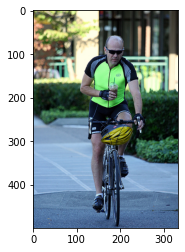

Expert Caption: ['biker enjoys coffee', 'man in bright green shirt and sunglasses is riding bicycle through the streets whilst drinking latte', 'man in bright green shirt riding bicycle in paved courtyard carying drink', 'man rides on his bike with one hand and holds drink with the other', 'man riding bike wearing green shirt with drink in his hand']
Blue score 2.2250738585072626e-308
caption: boy in red shirt and helmet riding her bike down the street


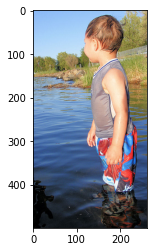

Expert Caption: ['boy in bathing suit stands in water', 'little boy stands in creek on sunny day', 'toddler wearing colorful shorts is standing in the water', 'wet child standing in water', 'little boy kneedeep in water']
Blue score 0.12500000000000003
caption: child in blue bathing suit is splashing in the water


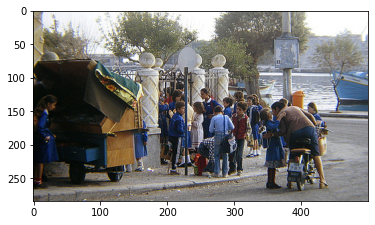

Expert Caption: ['girl kisses her mother goodbye before she waits with the other children to start school', 'group of children in blue clothes stand by gate', 'group of students in uniform stand in front of the gate', 'crowd of people near the water', 'group of schoolchildren in uniforms standing at gate one kissing her mother goodbye']
Blue score 2.2250738585072626e-308
caption: group of people are walking on sidewalk


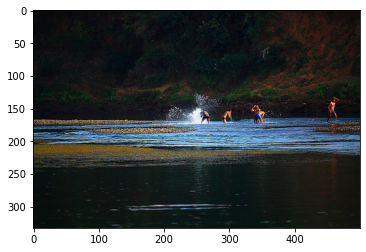

Expert Caption: ['group of friends play in lake', 'five people are in natural water source', 'many children play in the water', 'people in bathing suits bend down and reach into the water of lake', 'several people are playing outside in the water']
Blue score 2.0471667756573244e-308
caption: man is standing on the shore with fishing pole in the background


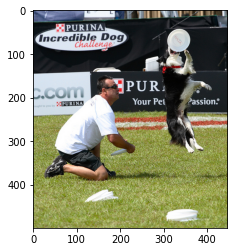

Expert Caption: ['black and white dog catches flying discs thrown by man', 'black white dog catching frisbees thrown by man in white shirt', 'dog jumps for frisbee at the purina incredible dog challenge', 'man is throwing freesbies into the air and the border collie is catching them in the air', 'man in white shirt tossing frisbee for black and white dog who has white frisbee in its mouth']
Blue score 1.142391010069532e-308
caption: man is playing with white poodle


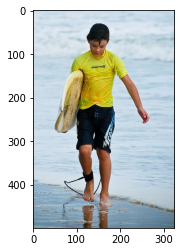

Expert Caption: ['boy in yellow shirt is walking on beach holding surfboard', 'boy in yellow shirt walks with his surfboard out of the ocean', 'little boy at the beach with surfboard', 'young boy in yellow rash guard is walking on the shore carrying surfboard', 'young boy wearing yellow shirt walking on the beach carrying surfboard']
Blue score 1.991083571408152e-308
caption: boy in blue shorts is running in the water


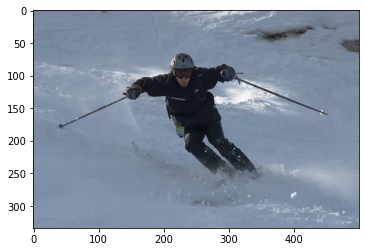

Expert Caption: ['man skiing down hill', 'man skis down snowy hill', 'person skis downhill', 'skier dressed in black speeds down the mountain', 'closeup of skier with his poles out wide to the side']
Blue score 2.0133300850710214e-308
caption: young girl in red coat is playing in the snow


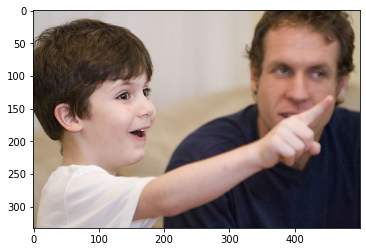

Expert Caption: ['boy points', 'boy points at something while man looks', 'boy smiles at points at something man looks to the side', 'little boy smiles and points while man looks in the direction of the child gaze', 'the man in the blue shirt is looking in the direction to which the little boy is pointing']
Blue score 2.2250738585072626e-308
caption: little boy with his eyes closed is smiling and holding hands


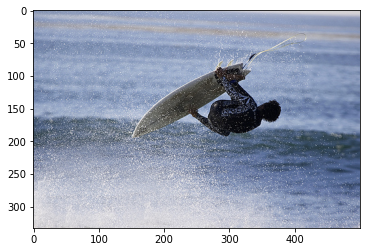

Expert Caption: ['lone surfboarder jumping wave on white surfboard', 'man flies into the air with his surfboard', 'person in wetsuit is in midair while surfing', 'surfer is in the air above the ocean', 'surfer performs trick']
Blue score 2.2250738585072626e-308
caption: dog is running through the water with stick in its mouth


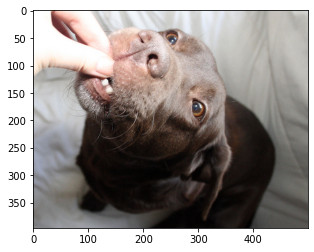

Expert Caption: ['brown dog looks up while person fingers are in its mouth', 'dog bites someone finger', 'dog is chewing on someone finger', 'person has his or her hands in dog mouth', 'person touches dog tooth']
Blue score 2.2250738585072626e-308
caption: dog is biting its nose


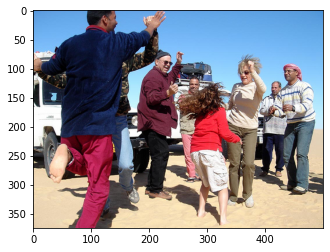

Expert Caption: ['girl dances with adults in the sand', 'group of people dancing on beach in front of truck', 'friends and family dance on beach by their vehicles', 'many people dancing in sandy desert', 'several people are dancing in some sand']
Blue score 0.0909090909090909
caption: group of people are standing in the snow with mountains in the background


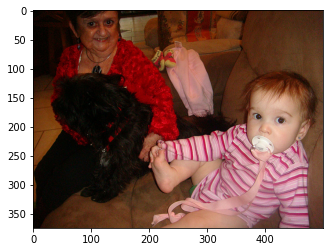

Expert Caption: ['baby in pink striped clothing is sitting near an older lady wearing red and black', 'baby sitting next to very old woman', 'baby with pink outfit on has pacifier and she is on chair with another woman', 'woman in red shirt is holding black dog on brown sofa with little girl wearing striped onsie with pacifier in her mouth', 'the baby sitting next to the black dog is sucking pacifier']
Blue score 2.2250738585072626e-308
caption: two young boys are playing with toys


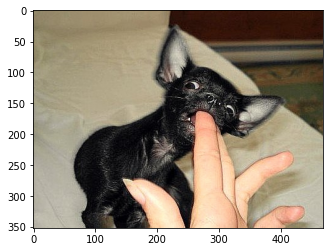

Expert Caption: ['small black dog biting ladies two fingers on beige couch', 'small black dog chews on fingers', 'small dog bites ladies fingers', 'small black dog biting on person finger', 'small black dog biting the fingers of woman']
Blue score 2.2250738585072626e-308
caption: the dog is laying on its hind legs next to the blue and blue blanket


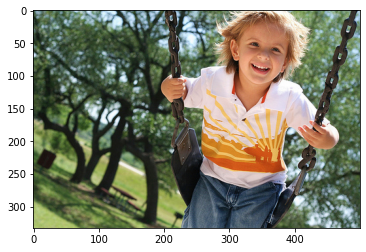

Expert Caption: ['blonde boy in white and orange tshirt is playing on swing', 'boy in surfing shirt is swinging on swing', 'child is smiling while being on swing', 'little boy swings at the playground', 'young child swinging on swing']
Blue score 2.2250738585072626e-308
caption: boy in blue shirt is playing in the water


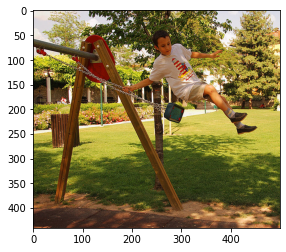

Expert Caption: ['boy jumping off swing', 'boy jumps off swing on the swing set when its high enough', 'child in white shirt coming out of swing in midair', 'young boy leaps off swing', 'the boy wearing white is leaping from the swing']
Blue score 2.2250738585072626e-308
caption: two girls are playing in the water


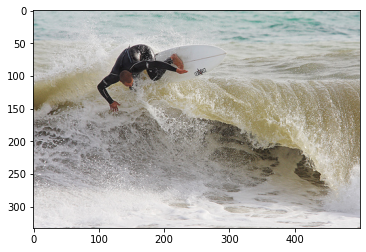

Expert Caption: ['man surfing wave', 'surfer in wetsuite jumps waves', 'surfer is riding his board over wave', 'surfer on white board catches wave', 'the man turns with the wave on his surfboard']
Blue score 0.25
caption: surfer is riding wave on surfboard


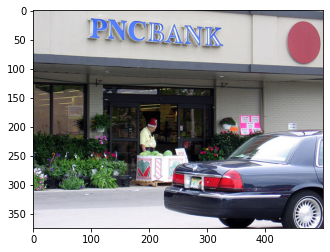

Expert Caption: ['man stands outside bank selling watermelons', 'man with red shriner hat is looking at watermelons in front of bank', 'dark colored mercury car parked in front of pnc bank', 'the man is looking at watermelons for sale outside of bank', 'there is man wearing funny hat standing in front of bank']
Blue score 0.3333333333333333
caption: three people are standing in front of building


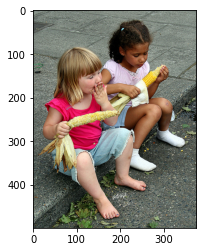

Expert Caption: ['two cute little girls enjoying corn on the cob', 'two girls enjoy corn on the cob while sitting on curb', 'two little girls sitting on the edge of street eating corn on the cob', 'two young girls are sitting on the street eating corn', 'two young girls eating corn on the cob on sidewalk without shoes']
Blue score 2.2250738585072626e-308
caption: two children are playing with rubber swords in the grass


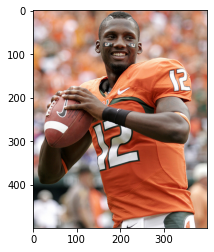

Expert Caption: ['football player wearing an orange jersey holding football', 'football player wearing an orange uniform smiling and holding the football', 'man in an orange jersey with the letter on it plays football', 'university of miami player holds football', 'number in orange gets ready to throw the football']
Blue score 2.2250738585072626e-308
caption: tennis player in red and white uniform is holding football


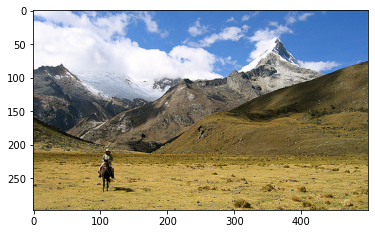

Expert Caption: ['man on horseback on grassy field in front of mountains', 'person on brown horse in prairie in front of tall mountains', 'person riding horse with mountain range in the far background', 'rider on horse in front of mountain range', 'distant horse rider on plain in the middle of brown mountains']
Blue score 2.2250738585072626e-308
caption: two people are standing on rocks overlooking the water


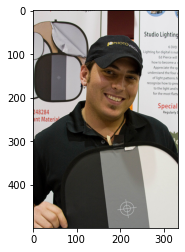

Expert Caption: ['man in black cap and shirt smiling while holding white grey and black rectangular object', 'man smiles and poses with product he appears to be trying to sell', 'man wearing black shirt and baseball cap smiling', 'the man is wearing black shirt and hat and smiling', 'there is man with black shirt and black hat smiling']
Blue score 0.14285714285714285
caption: man with glasses and glasses is wearing black jacket


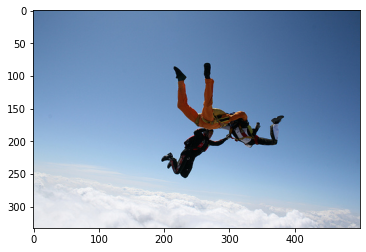

Expert Caption: ['three person sky dive team in the air performing stunt', 'three people wearing parachutes are freefalling together through the sky', 'three skydivers are in formation above the clouds', 'trio of skydivers holding hands in sky', 'two people are parachuting over white clouds']
Blue score 2.2250738585072626e-308
caption: man is jumping over railing near the ocean


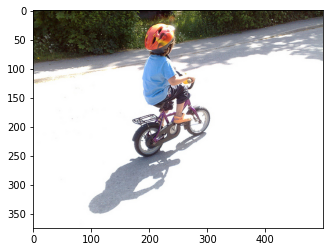

Expert Caption: ['little boy with blue shirt is wearing helmet and riding two wheeled bike', 'young boy rides purple bike', 'young child is riding purple bike', 'young child rides small purple bike while wearing red helmet', 'young child wearing bike helmet rides two wheel bike']
Blue score 2.2250738585072626e-308
caption: man in red shirt and red helmet is riding bike through the woods


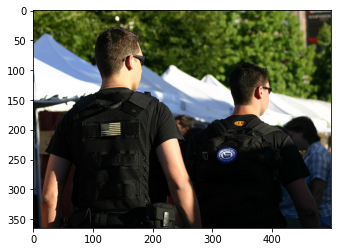

Expert Caption: ['men wearing sunglasses with their backs turned to the camera', 'the backs of two men wearing backpacks near some tents', 'two men in black bulletproof vests watch something taking place to the right of the picture', 'two men in black outfits have backpacks', 'two men in bullet proof vests watch over crowd by some white tents']
Blue score 2.2250738585072626e-308
caption: two men are standing outside of building


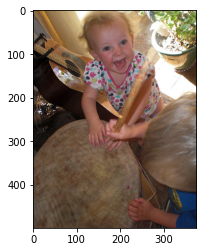

Expert Caption: ['baby girl and little boy are standing next to guitar and drum', 'young laughing girl and boy are playing on big drum', 'two little kids are beating on bongo drum', 'two small children with blonde hair are playing drum one is smiling', 'two young children are playing with drum']
Blue score 1.491511611267286e-308
caption: baby is playing with toys


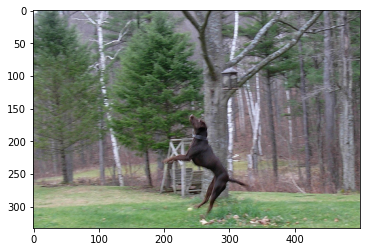

Expert Caption: ['black dog jumping', 'brown dog is jumping on its hind legs', 'brown dog is leaping into the air in front of wooden structure in pine forest', 'brown dog jumping off the ground in the woods', 'the dog leaps into the air in field']
Blue score 2.2250738585072626e-308
caption: man is standing on tree with tree in the background


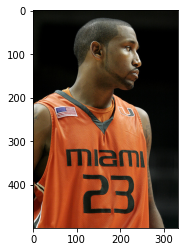

Expert Caption: ['man in miami basketball uniform looking to the right', 'man wears orange jersey', 'miami basketball player looks off in the distance', 'the mans shirt is orange and has united states flag patch on the shoulder', 'the miami basketball player is looking']
Blue score 2.2250738585072626e-308
caption: woman wearing white shirt and white beads is holding tennis racket


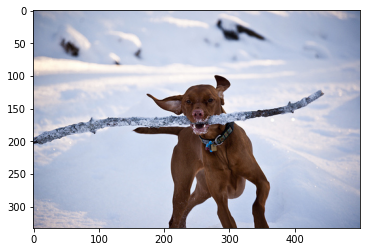

Expert Caption: ['brown dog holding huge stick in its mouth running in the snow', 'brown dog holding really big stick', 'dog in the snow carrying tree limb in its mouth', 'brown dog runs through snow with snow covered branch in its mouth', 'the brown dog running in the snow is carrying large stick also covered with snow']
Blue score 0.1278341881163385
caption: two dogs play with red ball in the snow


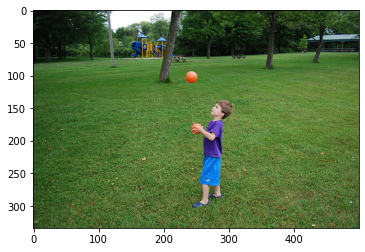

Expert Caption: ['boy in park playing with two orange balls', 'boy in purple shirt tosses orange balls on lawn', 'little boy in purple shirt and blue shorts playing with orange balls', 'boy playing on the grass with an orange ball', 'little boy juggling orange balls in the park with playground behind him']
Blue score 0.10145563514247358
caption: young boy in red shirt and blue shirt is playing soccer


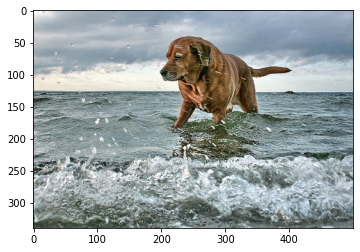

Expert Caption: ['dog standing in the shallow part of the ocean while the waves splash around', 'dog standing in the water', 'wrinkled dog wading in shallow water', 'the large brown dog is walking through water in the ocean', 'the large brown dog stands in the choppy water']
Blue score 2.2250738585072626e-308
caption: young boy is walking along the beach with an orange toy in the background


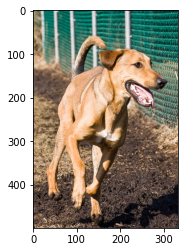

Expert Caption: ['brown dog running through the dirty muddy grass', 'dog running along fence on dirt track', 'light brown dog runs happily by green fence', 'orange dog runs on dirt beside green fence', 'the large brown dog is running outside in the dirt']
Blue score 2.2250738585072626e-308
caption: two dogs are playing with red ball in the grass


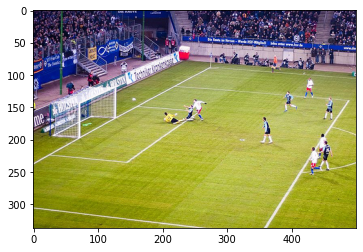

Expert Caption: ['ball is about to enter goal at soccer match', 'soccer player in white shirt kicked goal', 'soccer player tries to kick the ball in the goal', 'soccer team scores goal', 'goal attempt during soccer game being played on green grass']
Blue score 2.2250738585072626e-308
caption: two children are playing soccer in front of large building


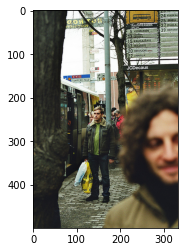

Expert Caption: ['man is standing on sidewalk in the background with blurry image of another man in the foreground', 'man stands at busy bus stop', 'man stands next to bus', 'people in the city', 'people walking down the street and past an open bus']
Blue score 2.2250738585072626e-308
caption: little boy in yellow shirt is jumping into the air


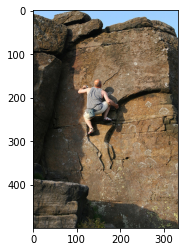

Expert Caption: ['man dressed in grey climbing large brown rock', 'man in gray shirt climbs large rock wall', 'man in shorts climbs rock face', 'man climbing rock wall', 'the back of man climbing rock']
Blue score 2.2250738585072626e-308
caption: man is rock climbing


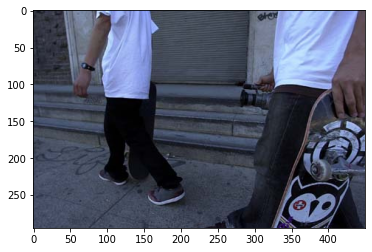

Expert Caption: ['the camera focuses on two people legs', 'the legs and midsections of two people with skateboards', 'two guys walking one carrying skateboard', 'two male skaters walk on sidewalk', 'two people wearing white shirts and jeans each carrying skateboard']
Blue score 2.2250738585072626e-308
caption: woman in white shirt and white pants is walking past white building


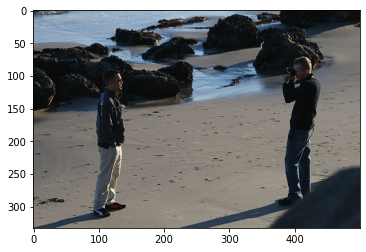

Expert Caption: ['man on the beach is taking picture of another man', 'man posing for his photo on rocky beach', 'man takes picture of another man at the beach', 'man filiming man with sunglasses at the beach', 'two men are standing on rocky shore while one photographs the other']
Blue score 0.16666666666666669
caption: two people are standing on top of mountain


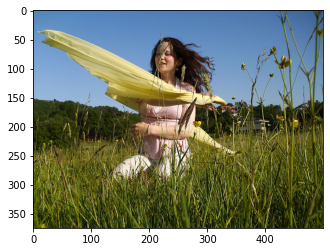

Expert Caption: ['girl in field with yellow scarf', 'girl in along grass field is spinning some yellow material around her', 'woman in field enjoys her clothing being blown by the wind', 'young woman in sunny meadow watches her yellow scarf blow in the wind', 'woman in field of tall grass and wildflowers holding up yellow scarf']
Blue score 0
caption: two people are walking through shallow water


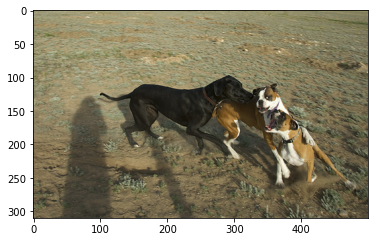

Expert Caption: ['black dog and two brown and white dogs are romping in the mud', 'the three dogs play in the sand', 'three dogs are playing in field', 'three dogs are playing rough in sandy field', 'three dogs chase and wrestle together on dirt field']
Blue score 2.2250738585072626e-308
caption: two dogs are walking through the woods


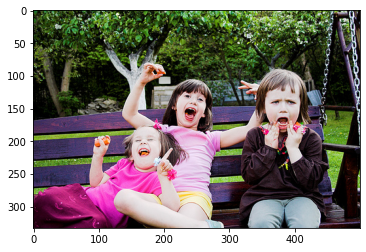

Expert Caption: ['three children are pulling faces on purple bench', 'three little girls are sitting on purple bench and making funny faces', 'three little girls make silly faces on wooden swing in an over saturated photo', 'three young girls are sitting on bench swing in park', 'three young girls pose together outside']
Blue score 0.2222222222222222
caption: two girls are sitting on the grass in front of lake


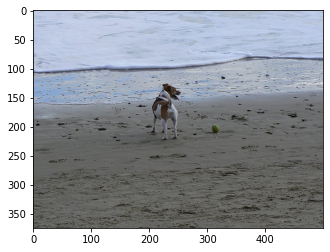

Expert Caption: ['brown and white dog is standing on beach with tennis ball beside it', 'dog is on the beach near ball', 'dog on the beach', 'the brown dog is standing next to ball on the beach', 'the dog stands in the sand near the ocean']
Blue score 2.2250738585072626e-308
caption: the beagle is running along the beach


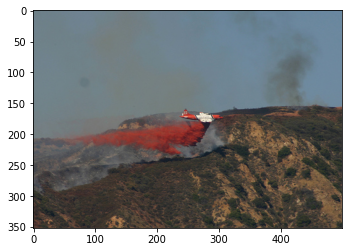

Expert Caption: ['airplane emitting heavy red colored smoke', 'an airplane is flying over the mountain trying to extinguish fire', 'small plane is dropping red chemical over the mountaintops', 'red spray is being ejected by an orange and white plane flying over the hilltops', 'small red airplane flies over mountaintop dropping red substance over fire']
Blue score 0
caption: man stands on rock with his arms out


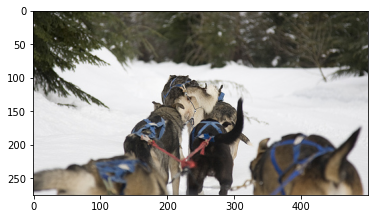

Expert Caption: ['dog sled team seen from behind', 'group of dogs harnessed together to pull something in the snow', 'sled dog team running from the perspective of the rider', 'sleddog team works hard on this snowy trail', 'several dogs in the snow all harnessed in line']
Blue score 2.2250738585072626e-308
caption: two men are standing on rocks near the mountains


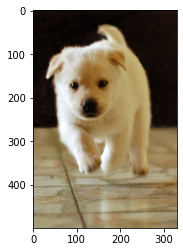

Expert Caption: ['beige puppy walks across the floor', 'small puppy rungs towards the camera', 'white puppy is running on tiled floor', 'puppy running on the floor', 'the white dog ran across the tile floor']
Blue score 2.2250738585072626e-308
caption: small white dog is running through the grass


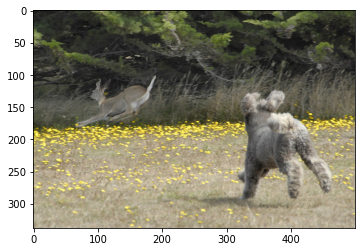

Expert Caption: ['dog chases deer into the woods', 'dog chases deer on field with yellow flowers', 'dog chasing deer in field of yellow flowers', 'dog chasing deer in field with yellow flowers', 'the dog chases deer near the woods']
Blue score 2.2250738585072626e-308
caption: two dogs are running through the water


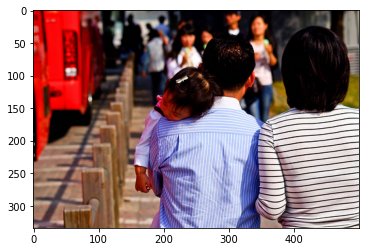

Expert Caption: ['couple are walking along street while the man carries toddler over one shoulder', 'couple is walking away while an infant sleeps on the father shoulders', 'man carries child while he walks with woman', 'man holding sleeping child walks with woman', 'the man walking next to the woman up the steps has sleeping child on his shoulder']
Blue score 2.2250738585072626e-308
caption: woman in black and white dress is standing in front of crowd of people


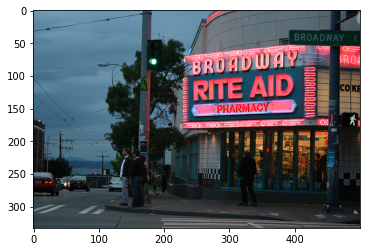

Expert Caption: ['people stand on street corner at dusk with pharmacy in the background', 'people stand outside of the rite aid pharmacy on broadway', 'people waiting to cross the street in front of pharmacy with lit up sign', 'some people look to cross the street in front of drug store', 'this is picture of broadway rite aid pharmacy that has bright neon sign and people are prepared to cross the street in front of it']
Blue score 1.7328892633971685e-308
caption: people are standing in the circle of building


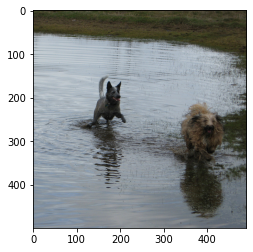

Expert Caption: ['grey dog chasing brown dog in shallow water', 'small black dog chasing small fluffy brown dog just above water', 'two dogs moving through water close to the shore', 'two dogs playing in lake', 'two dogs playing on the shore']
Blue score 2.2250738585072626e-308
caption: two dogs swim in the water


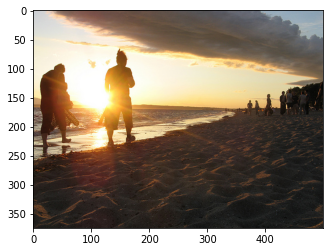

Expert Caption: ['bunch of people on the beach at sunset', 'two people are walking towards group of people on the beach at sunset', 'two people walking along the beach at sunset towarn group of people', 'two people walking along the shore at sunset', 'two people walking on the beach at sunset']
Blue score 0.12500000000000003
caption: two people are standing on the shore overlooking the ocean


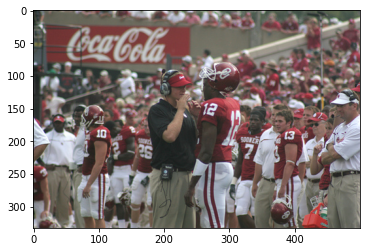

Expert Caption: ['coach speaking to football player while everyone watches', 'football player from ou talks to the coach about the game', 'football player is talking to his coach', 'the coaching official and football player are talking in front crowd and other team members', 'the coach talks it over with his quarterback during timeout']
Blue score 2.2250738585072626e-308
caption: group of people are standing in front of crowd


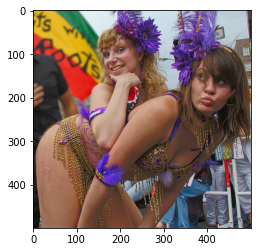

Expert Caption: ['two girls dressed in costume with purple flowers in their hair strike pose for the camera', 'two showgirls are posing together', 'two woman are showing different facial expressions and wearing gold and purple costumes', 'two women in purple and gold dance outfits are posing', 'two women in sparkling bikinis are posing']
Blue score 1.991083571408152e-308
caption: the little girl is wearing pink and pink outfit


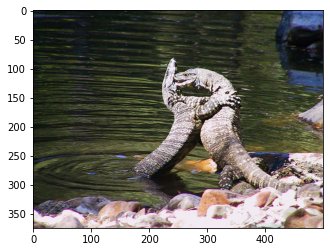

Expert Caption: ['the iguanas wrestled along the rocky water bank', 'the two reptiles are standing on their back legs near deep water', 'two lizards fighting', 'two lizards fight in the water', 'two oriental lizards are fighting for dominance in small pond']
Blue score 2.2250738585072626e-308
caption: boy in swimming trunks is splashing in mud puddle


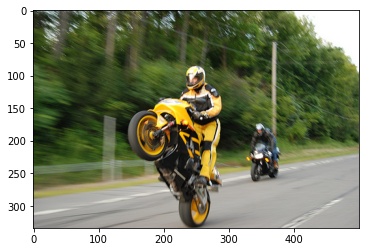

Expert Caption: ['man on motorcycle riding on his back tire', 'man on yellow sport bike does wheelie as his friend on black bike catches up', 'yellow motorcyclist is popping wheelie', 'the orange rider is driving motorcycle on one wheel', 'two motorcyclists on blurry road one rider doing wheelie']
Blue score 2.2250738585072626e-308
caption: two bicyclists are racing down road


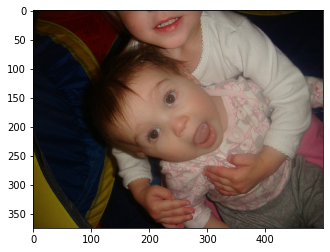

Expert Caption: ['little girl hugs another little girl', 'young child is being held by another child looking straight at us', 'two toddlers posing for the camera', 'two young children holding each other and posing', 'two young girls hug']
Blue score 2.2250738585072626e-308
caption: little boy in blue shirt is eating


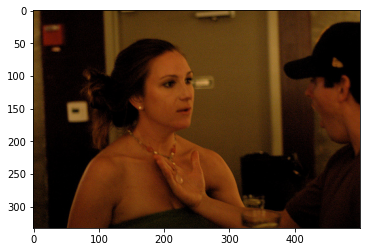

Expert Caption: ['man checks out the beautiful necklace woman is wearing', 'man stands across from woman and holds her necklace while she looks at him', 'man with shocked expression on his face is holding beaded necklace that is around woman neck', 'the man in the black hat holds the brown hair woman necklace', 'there is man looking girls necklace']
Blue score 2.2250738585072626e-308
caption: woman in black shirt and glasses is standing next to man in black shirt and woman in white shirt


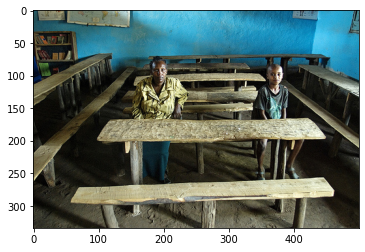

Expert Caption: ['an african man and boy are standing behind coarse wooden table in blue room', 'young boy and an older woman sitting at brown table in blue room', 'the person in the yellow shirt is sitting with child at wooden picnic table', 'two people sit in front of tables in room with blue walls', 'two people sitting in blue room with ratty wooden seats and tables']
Blue score 2.031716533983919e-308
caption: little boy in red shirt is climbing down an orange slide


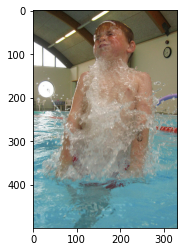

Expert Caption: ['boy is making splash in swimming pool', 'child is splashed by water in an indoor swimming pool', 'little boy is jumping out of the pool', 'redheaded boy has just come up from under the water in pool', 'young boy playing in swimming pool']
Blue score 2.2250738585072626e-308
caption: boy is swimming underwater in pool


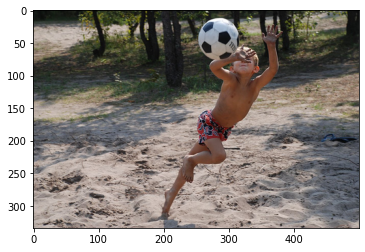

Expert Caption: ['boy in red and blue shorts is trying to catch soccer ball while running in sand', 'young boy wearing red bathing suit reaches for soccer ball', 'kid guards face from soccer ball', 'the little boy in red trunks is attempting to catch soccer ball that is coming towards him', 'young boy plays ball on the beach']
Blue score 2.2250738585072626e-308
caption: young girl in pink shirt and white shorts is running through the grass


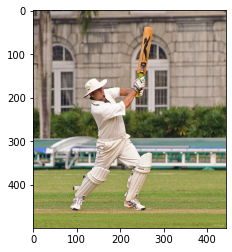

Expert Caption: ['man playing cricket his bat pointed to the sky', 'man dressed in white playing sports', 'the cricketer is swinging bat in the air', 'the man wearing knee protectors swings cricket club', 'the man wearing white clothes and white leg padding is practicing sport']
Blue score 0.0909090909090909
caption: baseball player in white and white uniform is swinging bat for the ball


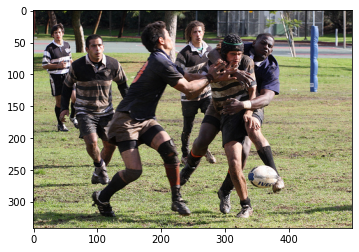

Expert Caption: ['bunch of men play rugby on muddy field', 'group of men are playing rugby', 'group of men are playing rugby', 'group of opposing players are in the middle of rugby game', 'men play rugby']
Blue score 1.8217363958297824e-308
caption: two football players play football


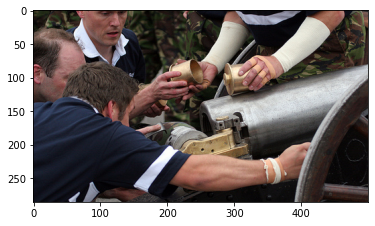

Expert Caption: ['group of men are changing the shells on cannon', 'group of men loading cannon', 'several men loading metal cannon', 'several people work on machine', 'some men try to load what looks like cannon']
Blue score 0
caption: young boy is feeding water bottle


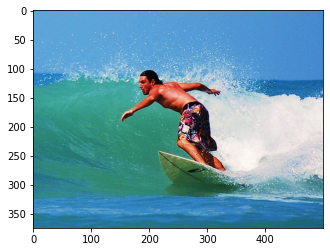

Expert Caption: ['man in colorful shorts is surfing under wave', 'man in colorful trunks surfing wave on white surfboard', 'surfer rides wave in clear blue ocean', 'surfer surfs wave', 'man in multicolor trunks riding surfboard on wave']
Blue score 1.8834843577582417e-308
caption: child is surfing in the ocean


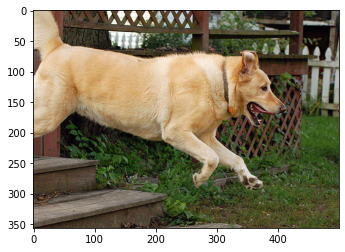

Expert Caption: ['blond dog runs down flight of stairs to the backyard', 'dog jumps off the stairs', 'tan dog runs down wooden staircase to the green grass', 'yellow dog is jumping across grassy yard in front of wooden deck', 'yellow dog jumping off of porch']
Blue score 2.2250738585072626e-308
caption: two dogs are playing with toy in yard


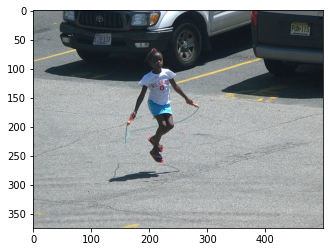

Expert Caption: ['girl is in parking lot jumping rope', 'little girl is jumping rope in parking lot', 'little girl jumps rope through parking lot', 'young girl jumps rope in parking lot in the midday sun', 'girl jumping rope in parking lot']
Blue score 2.2250738585072626e-308
caption: woman in bathing suit walks down the street


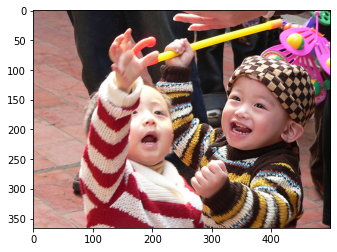

Expert Caption: ['one child reaches up for something while another stands beside him', 'one child with colourful toy and another child reaching up', 'two babies in sweaters playing with toy', 'two children have expressions of happiness as they reach for something out of sight', 'two kids playing on street']
Blue score 2.2250738585072626e-308
caption: the little boy is playing with the ball


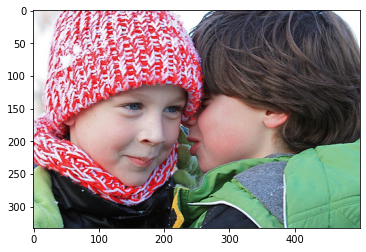

Expert Caption: ['boy is whispering to girl wearing red and white hat and scarf', 'one person is whispering to another', 'the boy is whispering in the girls ear', 'the child in the red and white hat is listening to the child with the brown hair and green jacket', 'two children standing very close']
Blue score 0.043478260869565216
caption: the little boy is wearing red and blue hat and holding red and pink and pink and blue and blue and blue and blue scarf


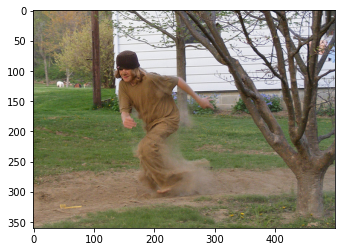

Expert Caption: ['boy is kicking up dust as he runs in the dirt by tree', 'boy wearing brown running in dirt', 'dirty boy runs through the dirt', 'dusty boy runs along dirt path through the grass', 'teenage boy runs through the dirt near house in the country']
Blue score 0.12500000000000003
caption: young boy in white shirt is running through the grass


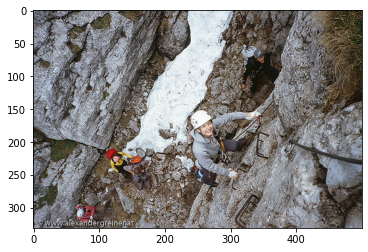

Expert Caption: ['woman wearing white helmeted looking up as she is calming huge rock wall', 'woman is climbing up steep mountain over water', 'people mountain climbing', 'people rock crawl up steep obstacle', 'these helmeted people are rock climbing outdoors']
Blue score 2.2250738585072626e-308
caption: man climbing up rock


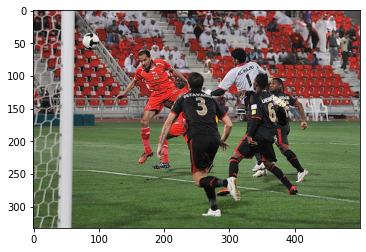

Expert Caption: ['bunch of people playing soccer', 'shotongoal action photo of soccer players in red and black uniforms', 'soccer player jumping in air during game', 'six soccer players on field with player in red uniform in the air and ball airborne', 'the red team knocked the ball toward the goal and the black team tried to block it']
Blue score 2.2250738585072626e-308
caption: two children play soccer in field


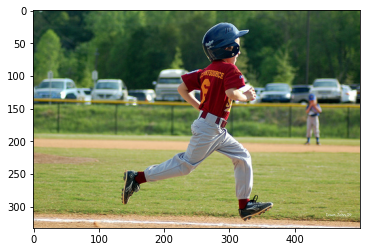

Expert Caption: ['boy in baseball uniform runs the bases', 'boy is running around the bases in baseball game', 'boy runs to baseball base', 'child in baseball uniform runs on baseball field', 'the young baseball player is running to one of the bases']
Blue score 2.2250738585072626e-308
caption: young boy running with bat in his hand


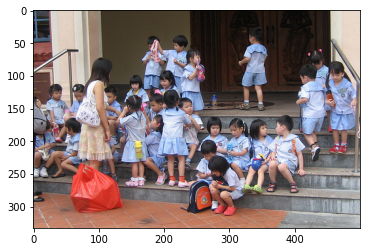

Expert Caption: ['bunch of asian children on steps', 'large group of asian children sit on or stand near steps', 'group of children in blue uniforms sitting on steps', 'little children in school uniforms congregate on the steps', 'many school children dressed in the same uniform are sitting on stairs']
Blue score 1.3495755153097447e-308
caption: children play in fountain


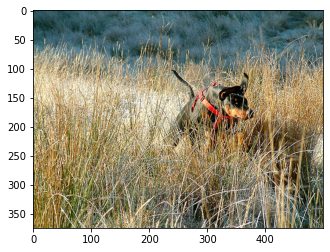

Expert Caption: ['brown and black dog jumping through field of long blades of grass', 'dog runs through the tall grass', 'dog wearing red harness runs across field', 'black and brown dog with red harness in high grass', 'dog running through the weeds']
Blue score 2.2250738585072626e-308
caption: the brown dog is running through field


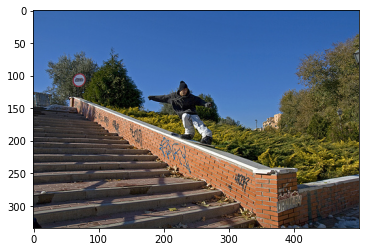

Expert Caption: ['man in black hoodie and jeans skateboards down railing', 'man skateboards down steep railing next to some steps', 'person is sliding down brick rail on snowboard', 'person walks down the brick railing near set of steps', 'snowboarder rides down handrail without snow']
Blue score 2.2250738585072626e-308
caption: three people are walking on bridge near the water


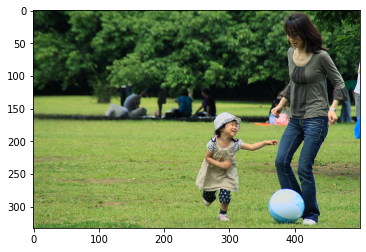

Expert Caption: ['child and her mother are playing ball in park', 'little girl with hat playing ball with her mom', 'young asian girl with woman plays with blue ball in part setting', 'young woman and her daughter play with blue and white beach ball in the grass', 'girl with tan dress and hat with woman in grey top with blue ball on ground']
Blue score 2.031716533983919e-308
caption: young boy in white shirt and blue jeans is playing soccer


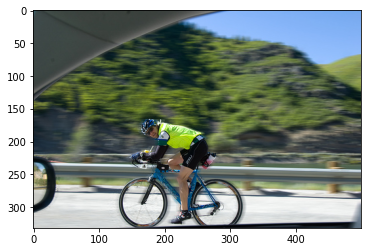

Expert Caption: ['bike rider in green jersey races along road', 'biker looks back at the camera for photo', 'cyclist in helmet and yellow jersey', 'man in safety vest riding bicycle on the highway', 'man in yellow shirt riding blue bicycle moving very fast']
Blue score 2.2250738585072626e-308
caption: man in helmet rides her bicycle down sidewalk


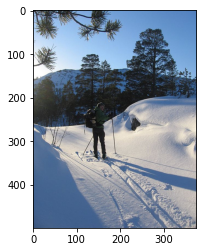

Expert Caption: ['crosscountry skier has left trail behind him as he makes his way through the snow', 'lone skier walking cross snowy bank with trees in the background', 'man is hiking on snowcovered trail', 'man is skiing down snowy hill while he casts long shadow', 'the skier moves down the hill on beautiful day']
Blue score 2.2250738585072626e-308
caption: man and woman are standing on the peak of the mountains


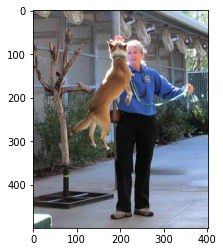

Expert Caption: ['dog jumping up to touch woman hand', 'dog jumps to an elderly woman', 'an airborne dog on leash with woman', 'the small dog is leaping in the air toward the woman hand', 'the woman in the blue sweater encourages the dog to jump in the air']
Blue score 2.2250738585072626e-308
caption: two girls are playing in the sprinklers


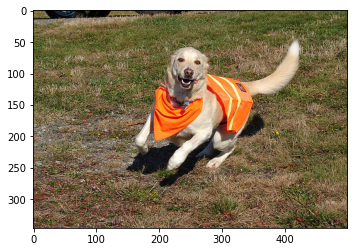

Expert Caption: ['beige dog with orange vest running on withering grass', 'dog wearing an orange vest scampers playfully across the grass', 'golden retriever running on short grass wearing an orange outfit', 'lightcolored dog wearing orange plays in the grass', 'the white dog is wearing orange clothing and running through the grass']
Blue score 0.25
caption: brown dog with red collar is running through the grass


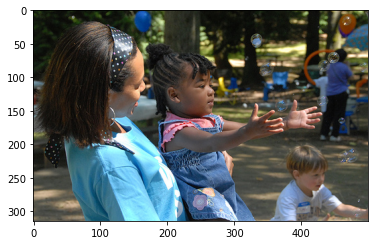

Expert Caption: ['lady holds little girl who is trying to catch bubbles', 'woman is holding little girl who is trying to catch bubbles', 'woman with holding young girl playing with bubbles at picnic', 'young woman in blue shirt stands holding young girl in denim dress', 'there is woman holding her baby daughter while the daughter claps']
Blue score 0.10000000000000002
caption: little boy in blue shirt is standing in front of some trees


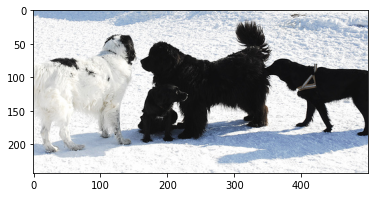

Expert Caption: ['group of dogs stand in the snow', 'four dogs stand in the snow', 'three black dogs and white dog are standing in the snow', 'two black dogs black puppy and white dog in the snow', 'two large black dogs one small black dog and one large white dog are standing in some snow']
Blue score 0.3333333333333333
caption: three black dogs are playing in the snow


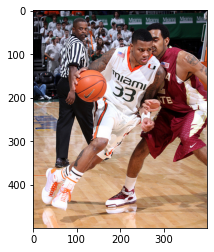

Expert Caption: ['basketball player dribbles the ball while another blocks him and an official looks on', 'basketball player in whit outfit is dribbling the ball around player in red outfit as the referee looks on', 'miami basketball player dribbles by an arizona state player', 'referee watches two basketball players playing basketball', 'the guard drives towards the basket during college basketball game']
Blue score 2.2250738585072626e-308
caption: two men in white jerseys are running in field


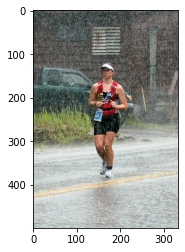

Expert Caption: ['loan runner participates in race in the rain', 'woman in red vest jogs down the street in heavy rain', 'woman runner in red is getting drenched in the rain', 'woman wearing red vest runs race through the rain', 'woman jogging in the rain']
Blue score 2.2250738585072626e-308
caption: young boy in red shorts is playing baseball


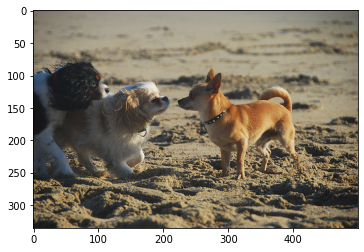

Expert Caption: ['the three dogs are standing in the sand', 'three small dogs stand in the sand and stare at each other', 'three small dogs two of which are sniffing noses', 'two dogs meet and check out third dog at the beach', 'two small dogs facing third dog']
Blue score 0.14285714285714285
caption: three dogs are playing with ball in the grass


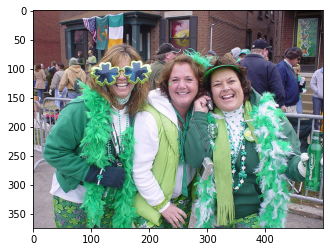

Expert Caption: ['there are women in st patrick day costumes', 'three women celebrate st patrick day by dressing up in green and white on busy street', 'three women dressed in green celebrating st patricks day', 'three women dressed up in green and shamrocks', 'three women wearing plenty of green and shamrocks']
Blue score 1.7665365515873297e-308
caption: three young girls in pink dresses are standing in front of flower flowers


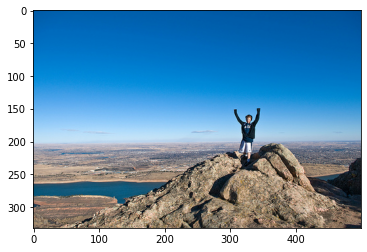

Expert Caption: ['man stands atop mountain with arms extended', 'person on top of mountain with arms over head', 'person stands at the top of mountain and raises his arms', 'man on top of mountain with his arms in the air', 'the man is standing on the rocks above the river with his arms in the air']
Blue score 2.2250738585072626e-308
caption: man stands on the beach overlooking the ocean


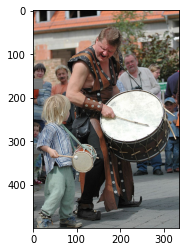

Expert Caption: ['large man in leather costume plays big drum beside little boy playing little drum', 'man and little boy beating drums', 'man plays drum and little boy hits his own little drum', 'the man with the big drum is marching next to boy with small drum', 'the small child bangs his drum whil looking at an older man doing the same']
Blue score 2.2250738585072626e-308
caption: woman in black and white dress is dancing with two hula hoops


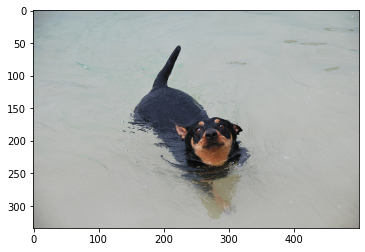

Expert Caption: ['black and brown dog is walking in the water and looking at the camera', 'black dog with brown on his face is swimming', 'brown and black dog swimming in river', 'large dog looks up as he swims', 'dog with black and tan face standing in water looking up at camera']
Blue score 0.2116204312226535
caption: two children play in the water


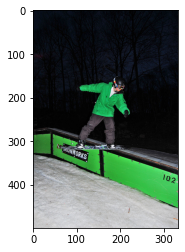

Expert Caption: ['helmeted boy flies through the air on snowboard', 'snowboarder balancing on wall', 'snowboarder in green grinds along the edge of rail at night', 'snowboarder wearing green jacket jumping green rainling', 'snowboarder wearing green jacket jumps above low gate']
Blue score 2.2250738585072626e-308
caption: girl in pink shirt is jumping into the air


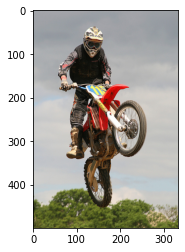

Expert Caption: ['dirt biker leaps through the air', 'person on motorcyle does stunt in the air', 'man on dirt bike', 'motocross rider during jump wearing black and white striped helmet', 'the red motocross bike and its rider are airborne above the trees']
Blue score 2.2250738585072626e-308
caption: man in red helmet rides bicycle on the road


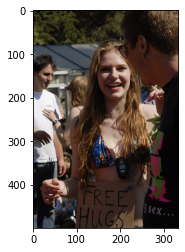

Expert Caption: ['girl in bikini wears sign saying free hugs', 'girl in blue bikini is wearing cardboard sign around her neck', 'girl wearing swimsuit top wears sign to give free hugs', 'girl wears sign that says free hugs', 'woman in blue bikini wearing free hugs sign']
Blue score 2.2250738585072626e-308
caption: woman in white dress and black hair is holding purse in her hand


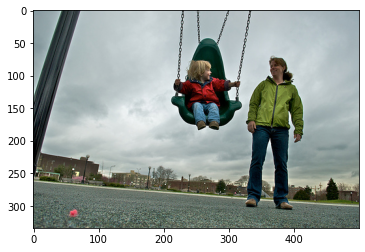

Expert Caption: ['child on kiddie swing being pushed by woman', 'an adult smiles with child on swing', 'young woman watches as young blond boy swings in chair swing with buildings visible in the background', 'the woman stands outdoors next to child in swing', 'woman standing with child on swing']
Blue score 2.2250738585072626e-308
caption: young boy in red shirt is jumping into the air


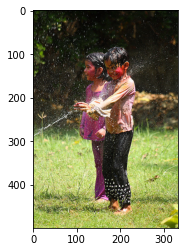

Expert Caption: ['children with painted red faces being sprayed with water on grass', 'the two children are being sprayed by water', 'two children playing in spray of water', 'two children standing in the grass being sprayed by hose', 'two indian children are being squirted by jet of water']
Blue score 2.2250738585072626e-308
caption: young boy in swimsuit is splashing in the water


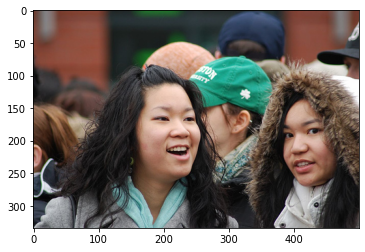

Expert Caption: ['girl with dark brown hair and eyes in blue scarf is standing next to girl in fur edged coat', 'an asian boy and an asian girl are smiling in crowd of people', 'the girls were in the crowd', 'two dark haired girls are in crowd', 'two girls are looking past each other in different directions while standing in crowd']
Blue score 2.0471667756573244e-308
caption: two girls in white dresses are standing in front of an office


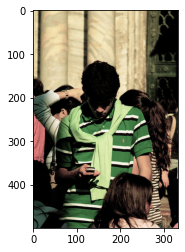

Expert Caption: ['darkskinned man in green shirt with green scarf looking at an electronic device', 'man in green shirt and sweater looks at his cellphone', 'man wearing green shirt looks down at cellphone', 'teenager standing in crowd of people texting on his phone', 'man with green shirt looks at phone']
Blue score 2.2250738585072626e-308
caption: boy is petting an old man in black shirt


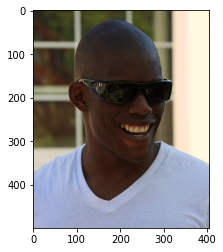

Expert Caption: ['an african american in sunglasses and white teeshirt smiles', 'young black man in sunglasses is smiling broadly', 'young man wearing dark sunglasses smiling', 'smiling bald black man in sunglasses and tshirt', 'the smiling black man is wearing white tshirt and dark sunglasses']
Blue score 2.2250738585072626e-308
caption: man with sunglasses and hat is wearing black shirt and sunglasses


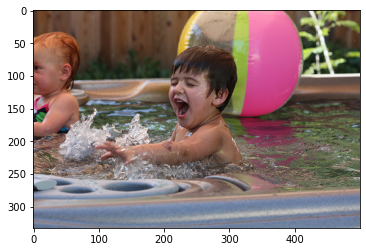

Expert Caption: ['boy with beach ball behind him playing in pool', 'young boy plays around in jacuzzi', 'children play in an inflatable pool', 'the boy laughed as he swam in the pool', 'two children are in pool with beach ball floating nearby']
Blue score 2.2250738585072626e-308
caption: baby in yellow shirt is playing in the fountain


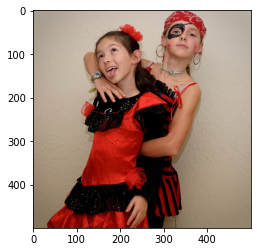

Expert Caption: ['girl dressed in red dress and another girl dressed as pirate are playing around', 'girls dressed in red and black costumes hold wrestling pose', 'two girls dress up for halloween', 'two girls in red costumes play together', 'two little girls in red and black costumes are posing for picture']
Blue score 0.0909090909090909
caption: two girls in pink dresses are standing in front of an orange building


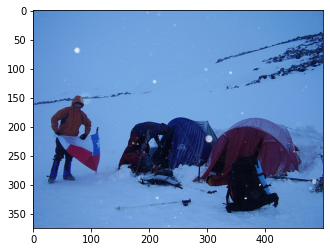

Expert Caption: ['man holds flag next to snowbound campsite', 'man with texas flag stands in the snow by tents', 'person setting up tent beside few other tents on the snowy ground', 'mountain climbers are setting up their tents', 'with pack and ski pole on the ground man wearing winter coat is holding tent while other tents are already set up']
Blue score 2.2250738585072626e-308
caption: three people are standing on snowy mountain


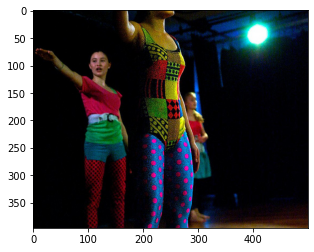

Expert Caption: ['girls dance in colorful outfits', 'the girls standing in spotlight are dressed in multicolored outfits', 'three girls in colorful outfits are dancing under stage light', 'three young girls in bright colored clothing are performing in play', 'women in multicolored outfits are performing on low light stage']
Blue score 2.2250738585072626e-308
caption: woman in pink and white dress is jogging in front of crowd


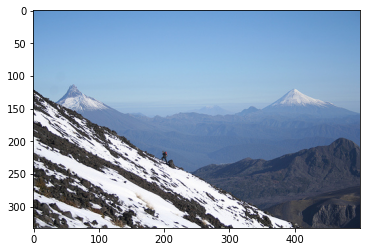

Expert Caption: ['man is climbing the mountain', 'mountain climber is seen on the side of tall mountain', 'solitary climber on snowy high mountains', 'snow covered mountains with person walking up in the background', 'the mountaintop is filled with snow']
Blue score 2.2250738585072626e-308
caption: man is standing on top of snowy peak


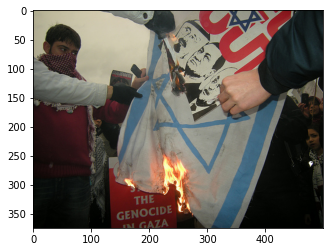

Expert Caption: ['masked man helps burn flag', 'man with covered face burning an israei flag in front of crowd', 'men burn an israeli flag', 'some middle eastern people have set an israeli flag on fire', 'the man is wearing red shirt and red flannel handkerchief while watching flag burn']
Blue score 2.2250738585072626e-308
caption: two girls are playing in fountain


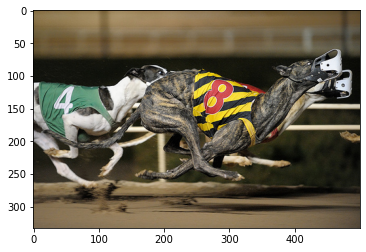

Expert Caption: ['group of dogs racing', 'number eight racing dog is beating number four racing dog slightly in race', 'several dogs wearing muzzles are racing on track', 'there are three dogs wearing numbered jerseys running race', 'three race dogs run to finish race']
Blue score 2.2250738585072626e-308
caption: two horses are jumping over the gate


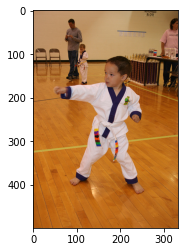

Expert Caption: ['boy poses in karate form and uniform', 'small child in karate uniform is punching', 'young boy is practicing his karate in gym', 'young boy practicing martial arts', 'the young child is standing in martial arts pose']
Blue score 2.2250738585072626e-308
caption: two girls are playing in the yard


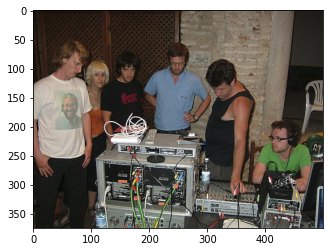

Expert Caption: ['group of people are standing around sound mixing table', 'group of people looking at sound equipment', 'people are inspecting sound equipment indoors', 'people examine equipment', 'six people standing behind electrical equipment']
Blue score 2.2250738585072626e-308
caption: two men are sitting in front of an outdoor cafe


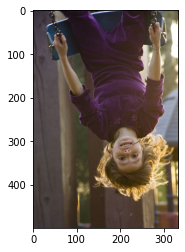

Expert Caption: ['child swings on swing', 'kid is upside down on swing', 'young child in purple shirt hanging upside down on swing', 'little girl upside down on swing', 'the girl wears purple outfit and swings upside down']
Blue score 2.2250738585072626e-308
caption: two girls in pink shirts play in the house


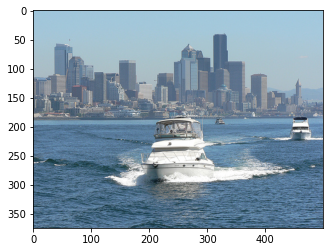

Expert Caption: ['few boats ride in the water in front of city skyline', 'large boat drives through the harbor', 'white boat is cruising near large city backdrop', 'small yachts in harbor city in background', 'there is white boat in the bay with city in the background']
Blue score 0.10000000000000002
caption: two people are sitting on the dock in front of an alley


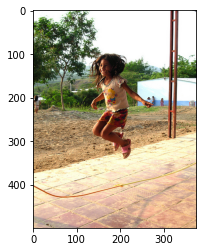

Expert Caption: ['girl jumping over jump rope', 'girl wearing pink shoes jumps over rope and smiles', 'girl wearing shorts plays jump rope', 'little girl is jumping over yellow rope', 'small girl with brown hair and big smile is jumping rope']
Blue score 0
caption: two girls are playing in sprinkler


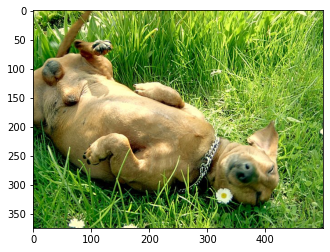

Expert Caption: ['brown puppy is laying on its back in the grass', 'dog lays down in the long green grass', 'dog rolling in the grass', 'dog rolls in the grass', 'golden dog is laying on its back in the grass']
Blue score 0.17337557995003636
caption: two dogs are playing in the grass


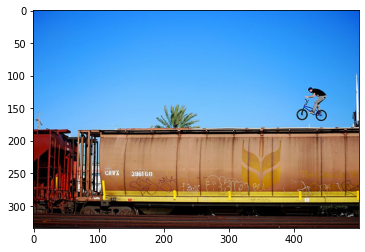

Expert Caption: ['man jumps train cars with his bike', 'man on bmx bike jumps over train', 'person is in the air while riding his bicycle on top of the train on clear blue sky day', 'person is jumping over train car while on their bicycle', 'person on bicycle moving across the top of train']
Blue score 2.2250738585072626e-308
caption: three people are sitting on bench in front of building


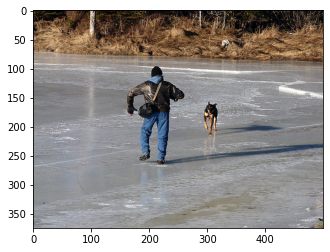

Expert Caption: ['man and dog running across shallow water on beach', 'man and his dog walk on the ice of frozen pond', 'man dressed in winter clothes is on the beach wiht dog', 'man in brown jacket is running on sandy bay towards dog that is in turn running towards him', 'the backview of man dressed up in jacket and dog running towards him']
Blue score 1.6720924800836196e-308
caption: two boys are walking along the beach


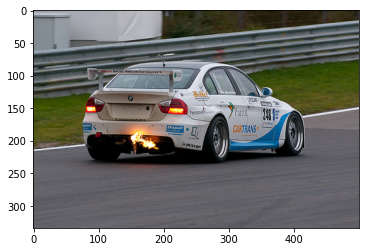

Expert Caption: ['race cars muffler catches on fire', 'race car sparks', 'sports car with flames coming out the exhaust', 'the blue and white race car has flames coming out of its tail pipe', 'the white racing car has fire bursting from its exhaust pipe']
Blue score 2.2250738585072626e-308
caption: white car is parked by two cars


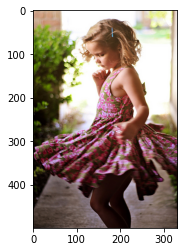

Expert Caption: ['girl twirls in pink dress', 'little girl dancing in pink and green dress', 'little girl twirls around in flowery dress', 'young girl in pink dress is dancing', 'blonde girl in green dress with pink flowers']
Blue score 2.2250738585072626e-308
caption: woman in pink bikini is walking down the street


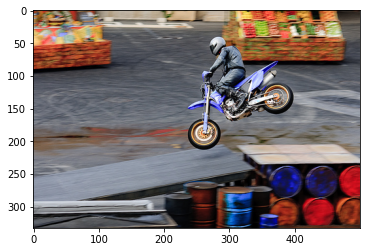

Expert Caption: ['blue motorcycle is jumping over some colored barrels', 'dirt biker lands on ramp', 'man riding blue motorcycle jumps over ramp', 'motorcyclist jumping on ramp', 'motorcyclist rides down ramp held up by colorful barrels']
Blue score 2.2250738585072626e-308
caption: boy in helmet is riding unicycle


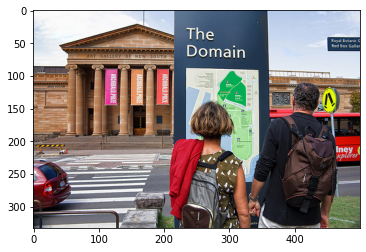

Expert Caption: ['couple are looking at an area map', 'man and woman are standing in front of an art gallery looking at map', 'tourists examine sign', 'two people are reading sign in front of museum', 'two people read sign in front of museum']
Blue score 0.16666666666666669
caption: woman in pink dress is walking past her shoe in front of an intersection


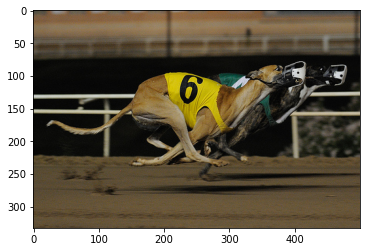

Expert Caption: ['brown number six race dog is slightly behind black race dog on track', 'two dogs race across the track', 'two greyhounds race', 'two muzzled greyhound dogs running around track', 'two muzzled racing dogs running along track']
Blue score 2.2250738585072626e-308
caption: two dogs are racing on the grass


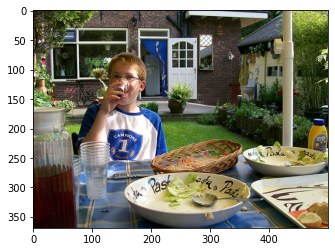

Expert Caption: ['young boy sits at picnic table and drinks out of small cup', 'boy drinking at backyard table full of bowls of food', 'child sitting at backyard picnic table', 'little boy is drinking out of glass at picnic', 'the boy drinks from plastic glass while sitting at table with food on it']
Blue score 2.2250738585072626e-308
caption: boy is sitting on train reading book


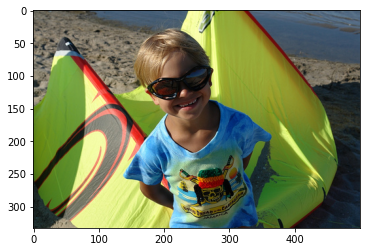

Expert Caption: ['blond boy in blue tee shirts stands smiling before craft of green nylon fabric', 'child poses wearing glasses near water outside', 'small girl smiling on the beach', 'young kid at the beach', 'young man wearing swimming goggles wearing blue shirt with pirate skull on it']
Blue score 1.8551618224632315e-308
caption: little girl in pink bathing suit is playing on red slide


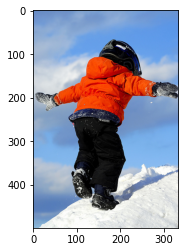

Expert Caption: ['kid walks on snowy hill with their arms out', 'little boy plays in the snow', 'toddler in red jacket is balancing on top of snow', 'young child wearing orange balances on snowy ledge', 'the little boy in black and orange walks through the snow']
Blue score 2.2250738585072626e-308
caption: child in red hat and jeans is standing on the of snow


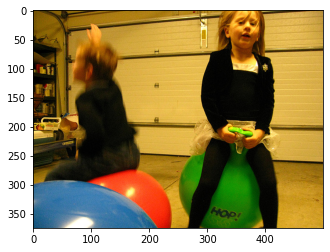

Expert Caption: ['boy and girl bouncing on ball', 'the children are wearing black tights while hopping', 'two children dressed in black bounce on red and green bouncy balls in garage', 'two kids are bouncing on colorful balls', 'two young children bouncing on balls']
Blue score 2.2250738585072626e-308
caption: two children are playing in the grass


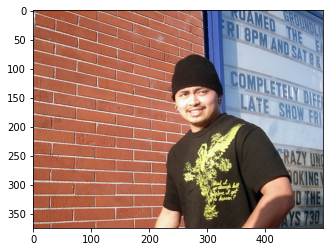

Expert Caption: ['man in black hat standing in front of brick wall and sign', 'man in knit cap stands next to brick wall', 'man standing in front of brick building', 'man wearing black shirt standing in front of red brick wall', 'the man in the black hat has his back to theater sign']
Blue score 0.0909090909090909
caption: an elderly woman in red jacket and backpack stands in front of building


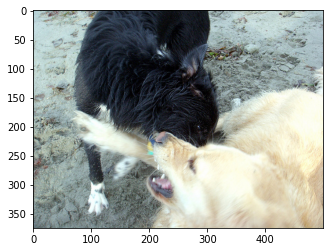

Expert Caption: ['black dog and tan dog fighting', 'black dog and white dog are wrestling on the ground', 'black dog bites white dog while standing on the sand', 'two dogs fight', 'two dogs one white and one black play with each other in the sand']
Blue score 2.2250738585072626e-308
caption: two dogs play tug of war with toy in their mouths


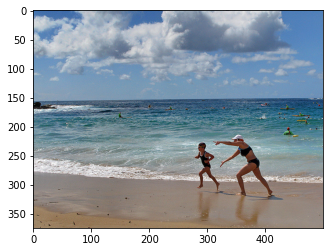

Expert Caption: ['an adult and child run on the beach', 'woman and little girl playing in the sand next to the ocean', 'two people run down the beach and one of them is pointing', 'two people running on beach', 'two people running on the shore of beach']
Blue score 0.16666666666666669
caption: man and woman are walking on the beach


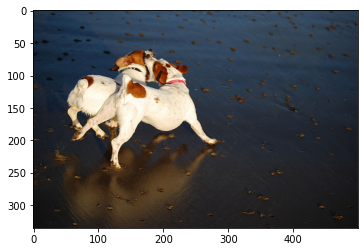

Expert Caption: ['dogs chase each other', 'two brown and white dogs wrestle while running across the wet sand', 'two dogs identical white with brown spots wrestle on jet black sand', 'two white and brown dogs playing on beach', 'two white dogs with brown markings playing']
Blue score 1.8834843577582417e-308
caption: two dogs are swimming in water


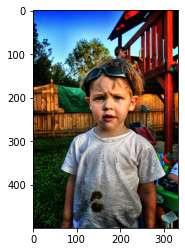

Expert Caption: ['boy wearing sunglasses on his head looks at the camera', 'child with sunglasses and shirt filled with dirt', 'young child with dirty shirt is standing on playground', 'child in dirty white shirt and sunglasses standing in yard', 'little boy who has played in the dirt standing near his swing set']
Blue score 2.2250738585072626e-308
caption: small child is smiling and holding hands in front of fence


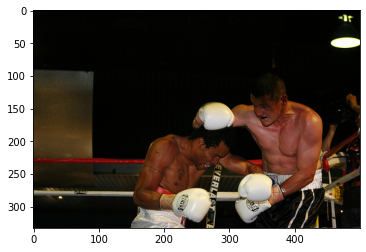

Expert Caption: ['the taller man is trying to block the shorter man', 'two boxers fiercely attacking each other', 'two boxers with white gloves are fighting', 'two men wearing white boxing gloves are in ring', 'two men with white gloves box in dimly lit boxing rink']
Blue score 0
caption: boy plays guitar


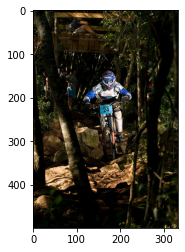

Expert Caption: ['dirt biker in the forest', 'dirt biker rides his motocycle through the woods', 'motocross bike is being ridden along woodland path', 'motorcyclist navigates forest trail', 'person rides motorbike on dirt path surrounded by trees']
Blue score 1.928867353251809e-308
caption: two children are jumping in the air


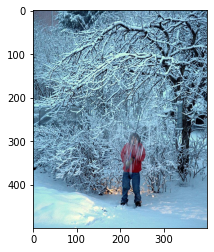

Expert Caption: ['boy in red jacket smacks snow covered tree with stick', 'child stands underneath snowcovered tree', 'little boy shakes the snow off of tree', 'person in red jacket stands under snowcovered tree', 'child standing in snowy landscape pulling down snowcovered tree branch']
Blue score 2.2250738585072626e-308
caption: man and woman are walking on the shore of mountain


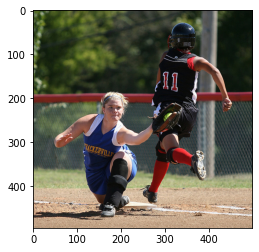

Expert Caption: ['girl in blue and white uniform tags someone in black and red uniform', 'girl is catching baseball before an opponent touches base', 'woman in blue has yellow ball in her mitt', 'girl in blue tries to get base runner number out during softball game', 'two people playing ball on field']
Blue score 2.2250738585072626e-308
caption: two girls are playing baseball in field


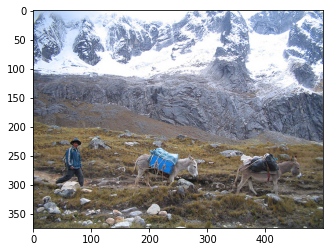

Expert Caption: ['boy is leading donkeys on path', 'man and two pack mules walk across field in front of mountain', 'man is walking in field behind two donkeys', 'man travels with two donkeys in the mountains', 'person in blue jacket follows two donkeys along mountain trail']
Blue score 2.2250738585072626e-308
caption: two boys are walking on the grass near the water


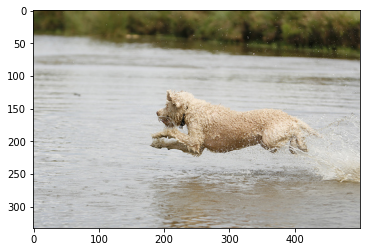

Expert Caption: ['dog leaps out of the water', 'small dog jumping threw some lake', 'tan dog jumps into water', 'white dog is splashing through the water', 'dog jumping out of water in lake']
Blue score 2.2250738585072626e-308
caption: dog is running through water


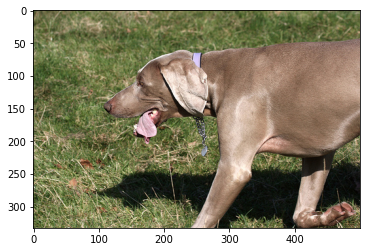

Expert Caption: ['brown dog is panting hard on grass during sunny day', 'brown dog walks in the grass with its tongue hanging out', 'dog running with tongue hanging out', 'grey dog walks in the green grass tongue hanging out', 'tan dog jogging with his tongue hanging out']
Blue score 0.25
caption: brown dog is biting red frisbee


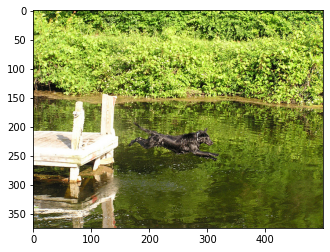

Expert Caption: ['black dog jumping from wooden deck into lake', 'black dog jumping off dock into water', 'black dog jumps into the water off dock', 'black dog jumps off of pier into lake', 'the dog is leaping into the pond']
Blue score 0.14285714285714285
caption: the dog is jumping over log in the woods


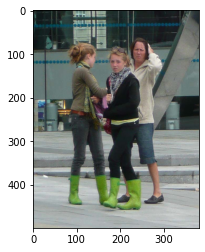

Expert Caption: ['three women standing on city street', 'three women walk down the street', 'two girls and woman walking on the sidewalk', 'two girls in bright green boots and woman are together', 'two young ladies in green boots are walking through an urban area while an older lady wearing black shoes follows them']
Blue score 0.2
caption: two women are walking down the street


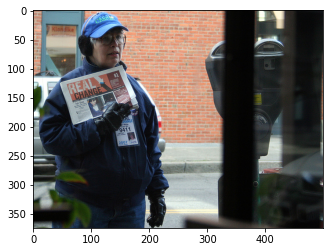

Expert Caption: ['person wearing blue jacket blue jacket and black earmuffs is holding up newspaper', 'woman holding newspaper', 'woman holds newspaper that says real change', 'woman with ear muffs holds paper that says real change on the cover', 'woman in holding up newspaper headline reading real change']
Blue score 2.2250738585072626e-308
caption: man in black jacket and backpack walking down the street


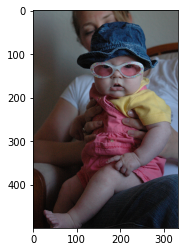

Expert Caption: ['baby is dressed up in pink gear and staring while an adult holds her steady', 'small baby wearing sunglasses sits on an adult lap', 'woman holds fat baby with sunglasses and denim hat', 'woman is holding onto baby wearing who is wearing sunglasses', 'the baby in blue jean hat and sunglasses looks at the camera while being held']
Blue score 1.3495755153097447e-308
caption: baby with red eyes is eating


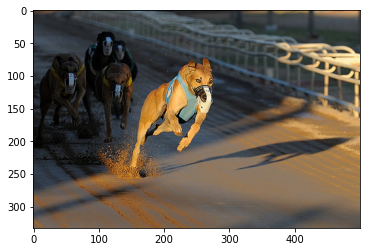

Expert Caption: ['dog with muzzle is leading several other dogs in race', 'greyhound leaps in race', 'muzzled dog in race with four dogs following', 'five dogs are racing', 'five dogs are racing on dirt track']
Blue score 2.2250738585072626e-308
caption: two dogs are running through the water


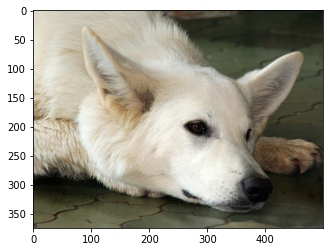

Expert Caption: ['closeup of white dog that is laying its head on its paws', 'large white dog lying on the floor', 'white dog has its head on the ground', 'white dog is resting its head on tiled floor with its eyes open', 'white dog rests its head on the patio bricks']
Blue score 0.2
caption: white dog is drinking water from fountain


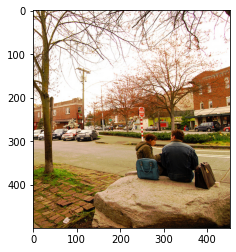

Expert Caption: ['couple are sitting on rock in front of street', 'man and woman sit on rock beside street', 'two people sit on large rock near city street', 'two people sitting on rock in city park', 'two people talk while sitting on big rock']
Blue score 0.3333333333333333
caption: two people sit on bench near the water


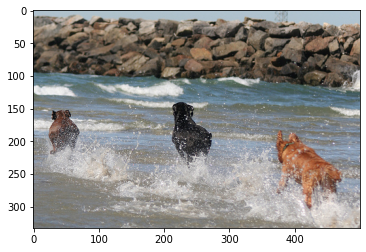

Expert Caption: ['brown black and tan dog run in the ocean', 'three dogs run into the water', 'three dogs running through water', 'three dogs run through surf near rocky outcrop', 'three dogs run through the water near the rocks and make splashes']
Blue score 2.2250738585072626e-308
caption: three boys are playing in the water


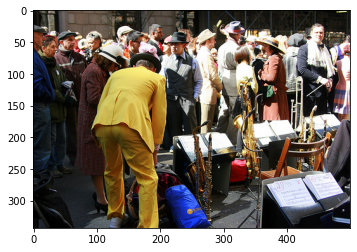

Expert Caption: ['crowd of people are standing around yellowsuited musician', 'man in yellow set up band next to crowd', 'musician and crowd next to stage full of musical instruments', 'man in yellowgold suit and hat leaning forward with musical instruments to his right', 'the man in the yellow suit stands near musical instruments and crowd']
Blue score 2.2250738585072626e-308
caption: many people are gathered in front of building with people


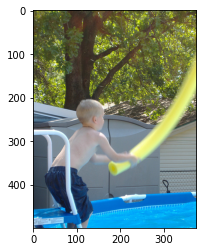

Expert Caption: ['boy holding large foam wand waves it near swimming pool', 'boy plays with foam noodle toy by pool', 'boy plays with noodle by the pool', 'child with water noodle', 'little boy wearing blue shorts is holding yellow noodle over pool']
Blue score 2.2250738585072626e-308
caption: young girl in pink shirt is jumping on trampoline
Negl count 162
decent count 38
decent average 0.21020259296958424


In [66]:
bleu_negl = 0
bleu_dec  = 0
bleu_dec_tot = 0
for z in range(200):
  pic = list(encoding_test.keys())[z]
  image = encoding_test[pic].reshape((1,2048))
  x=plt.imread(images+pic)
  plt.imshow(x)
  plt.show()
  img_caption = greedySearch(image)
  bleu_score = get_bleuscore(img_caption,pic)
  if bleu_score > 0.1:
      bleu_dec +=1
      bleu_dec_tot +=bleu_score
  else :
    bleu_negl +=1
  #print("image name",pic)
  print("Blue score",bleu_score)
  print("caption:", img_caption)
print ("Negl count",bleu_negl)
print ("decent count", bleu_dec)
print ("decent average", bleu_dec_tot/bleu_dec)

In [ ]:
for z in range(100):
  pic = list(encoding_test.keys())[z]
  image = encoding_test[pic].reshape((1,2048))
  x=plt.imread(images+pic)
  plt.imshow(x)
  plt.show()
  print("Greedy:",greedySearch(image))